In [0]:
# from IPython.display import HTML

# HTML('''<script>
# code_show=true; 
# function code_toggle() {
#  if (code_show){
#  $('div.input').hide();
#  } else {
#  $('div.input').show();
#  }
#  code_show = !code_show
# } 
# $( document ).ready(code_toggle);
# </script>
# The raw code for this IPython notebook is by default hidden for easier reading.
# To toggle on/off the raw code, click <a href="javascript:code_toggle()">here</a>.''')

## Import Libraries & Initialize Setup

In [0]:
import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
import matplotlib.cm as cm
from matplotlib.colors import ListedColormap

import seaborn as sns

import plotly.express as px
from plotly.subplots import make_subplots
import plotly.graph_objects as go
from plotly import tools

In [0]:
import warnings

import umap


from sklearn.preprocessing import StandardScaler, normalize
from sklearn.cluster import KMeans, AgglomerativeClustering, DBSCAN
from sklearn.mixture import GaussianMixture 
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.decomposition import PCA

from scipy.spatial import distance_matrix
from scipy.cluster.hierarchy import dendrogram, linkage, inconsistent, fcluster

from statsmodels.stats.multicomp import pairwise_tukeyhsd

In [0]:
# Generate Settings
sns.set()

colors = sns.set_palette('deep')

cmap = ListedColormap(sns.color_palette(colors))

sns.set_palette(colors)

warnings.filterwarnings('ignore')

## Define functions

In [0]:
def color_coder(clusters, colors):
    colored = {}
    for i, cluster in enumerate(clusters):
        colored[cluster] = colors[i]
    
    return colored

def silhouette_plot(X, y, cluster_range, limiter=[-1,1], model='kmeans'):
    
    ticks = [round(x,1) for x in np.arange(limiter[0],limiter[1]+.02,0.2)]
        
    for n_clusters in cluster_range:
        fig, (ax1, ax2) = plt.subplots(1, 2)
        fig.set_size_inches(18, 7)

        ax1.set_xlim(limiter)
        ax1.set_ylim([0, len(X) + (n_clusters + 1) * 10])

        if model == 'kmeans':
            clusterer = KMeans(n_clusters=n_clusters, random_state=42)
            mod_name = 'K-means'
        elif model == 'gaussian':
            clusterer = GaussianMixture(n_components = n_clusters)
            mod_name = 'Gaussian Mixture'
        else:
            print('Not a recognized model.')
        
        cluster_labels = clusterer.fit_predict(X)

        silhouette_avg = silhouette_score(X, cluster_labels)
        print("For n_clusters =", n_clusters,
              "The average silhouette_score is :", silhouette_avg)

        # Compute the silhouette scores for each sample
        sample_silhouette_values = silhouette_samples(X, cluster_labels)

        y_lower = 10
        for i in range(n_clusters):
            # Aggregate the silhouette scores for samples belonging to
            # cluster i, and sort them
            ith_cluster_silhouette_values = \
                sample_silhouette_values[cluster_labels == i]

            ith_cluster_silhouette_values.sort()

            size_cluster_i = ith_cluster_silhouette_values.shape[0]
            y_upper = y_lower + size_cluster_i

            color = cmap(float(i) / n_clusters)
            ax1.fill_betweenx(np.arange(y_lower, y_upper),
                              0, ith_cluster_silhouette_values,
                              facecolor=color, edgecolor=color, alpha=0.7)

            # Label the silhouette plots with their cluster numbers at the middle
            ax1.text(-0.05, y_lower + 0.5 * size_cluster_i, str(i))

            # Compute the new y_lower for next plot
            y_lower = y_upper + 10  # 10 for the 0 samples

        ax1.set_title("The silhouette plot for the various clusters.")
        ax1.set_xlabel("The silhouette coefficient values")
        ax1.set_ylabel("Cluster label")

        # The vertical line for average silhouette score of all the values
        ax1.axvline(x=silhouette_avg, color="red", linestyle="--")

        ax1.set_yticks([]) 
        ax1.set_xticks(ticks)

        # 2nd Plot showing the actual clusters formed
        colors = cmap(cluster_labels.astype(float) / n_clusters)
        ax2.scatter(X[:, 0], X[:, 1], marker='.', s=30, lw=0, alpha=0.7,
                    c=colors, edgecolor='k')

        # Labeling the clusters
        if model == 'kmeans':
            centers = clusterer.cluster_centers_
        
        elif model == 'gaussian':
            centers = clusterer.means_
        
        # Draw white circles at cluster centers
        ax2.scatter(centers[:, 0], centers[:, 1], marker='o',
                    c="white", alpha=1, s=200, edgecolor='k')

        for i, c in enumerate(centers):
            ax2.scatter(c[0], c[1], marker='$%d$' % i, alpha=1,
                        s=50, edgecolor='k')

        ax2.set_title('The visualization of the clustered data.')
        ax2.set_xlabel('Feature space for the 1st feature')
        ax2.set_ylabel('Feature space for the 2nd feature')

        plt.suptitle((f'''Silhouette analysis for {mod_name} clustering on 
        sample data with n_clusters = {n_clusters}'''),
                     fontsize=14, fontweight='bold')

    plt.show()

def clusters_stats_tests(dfs_dict, column, clusters):
    from scipy.stats import mannwhitneyu as mwu
    
    idx = ['count', 'mean', 'median', 'std'] + list(dfs_dict.keys())
    comp_df = pd.DataFrame()
    comp_df['idx'] = idx
    
    for nm,df in dfs_dict.items():
        count = len(df[column])
        mean = round(np.mean(df[column]),3)
        median = round(np.median(df[column]),3)
        std = round(np.std(df[column]),3)
        p = []
        for nm2,df2 in dfs_dict.items():
            p.append(str((round(mwu(df[column],df2[column])[1],5))))
        comp_df[nm] = [str(count), str(mean), str(median), 
                       str(std)] + p
        
    return comp_df

def segment_analysis_plots(df, plot_cols, seg_col, title='', clusters=[], xax=[], yax=[]):
       
    if len(clusters) != 0:
        plot_cols = plot_cols + [clusters[0]]
    
    if len(plot_cols) % 3 != 0:
        gh = int((len(plot_cols)) / 3) + 1
    else:
        gh = (len(plot_cols)) / 3
    
    fs = gh * 5
    
    plt.figure(figsize=(18,fs))
    
    plt.suptitle((f'{title}\n \n'), fontsize=22, y=0.98)
    
    if len(clusters) != 0:
        for i, col in enumerate(plot_cols):
            if i == plot_cols.index(clusters[0]):
                plt.subplot(gh, 3, i+1)
                if clusters[-1] == 'kmeans':
                    centers = clusters[5].cluster_centers_
                elif clusters[-1] == 'gaussian':
                    centers = clusters[5].means_
                    
                plt.scatter((clusters[2])[clusters[3]], (clusters[2])[clusters[4]], c=df[clusters[1]],
                           cmap=cmap)
                plt.scatter(centers[:,0], centers[:,1], marker='o', c='white', alpha=1, s=150)
                for i, c in enumerate(centers):
                    plt.scatter(c[0], c[1], marker='$%d$' % i, alpha=1, 
                                s=50, edgecolor='k')
            else:
                plt.subplot(gh, 3, i+1)
                plt.title(col, size=18)
                if len(xax) != 0:
                    plt.xlim(left=xax[0], right=xax[1])
                if len(yax) != 0:
                    plt.ylim(top=yax[0], bottom=yax[1])

                sns.boxenplot(df[seg_col], df[col])
    else:
        for i,col in enumerate(plot_cols):
            plt.subplot(gh, 3, i+1)
            plt.title(col, size=18)
            if len(xax) != 0:
                plt.xlim(left=xax[0], right=xax[1])
            if len(yax) != 0:
                plt.ylim(top=yax[0], bottom=yax[1])

            sns.boxenplot(df[seg_col], df[col])
    
    plt.show()

def data_clusters(df, column, components, model, model_type='kmeans'):
    
    #df = df.sort_values(by=[column])
    
    plt.figure(figsize=(14,8))
    plt.scatter(components[0], components[1], c=df[column], cmap=cmap)

    # Labeling the clusters
    if model_type == 'kmeans':
        centers = model.cluster_centers_
    elif model_type == 'gaussian':
        centers = model.means_

    # Draw and label centers
    plt.scatter(centers[:, 0], centers[:, 1], marker='o', c="white", alpha=1, s=200)
    for i, c in enumerate(centers):
        plt.scatter(c[0], c[1], marker='$%d$' % i, alpha=1, s=50, edgecolor='k')

    plt.title("The visualization of the clustered data.", fontsize=18)
    plt.xlabel("Feature space for the 1st feature")
    plt.ylabel("Feature space for the 2nd feature")

    plt.show()

def features_distributions_grid(subsets, plot_cols):
    if len(plot_cols) % 3 != 0:
        gh = int((len(plot_cols)) / 3) + 1
    else:
        gh = (len(plot_cols)) / 3
    
    fs = gh * 5
    r = 1
    c = 1
    subs = ['\nPlot_'+str(x+1) for x in range(len(plot_cols))]
    
    fig = make_subplots(rows=int(gh), cols=3, 
                        subplot_titles=subs)
    
    for i,col in enumerate(plot_cols):
        for nm,sub in subsets.items():
            trace = go.Histogram(x=sub[col], 
                                 name=nm, 
                                 legendgroup=col)
            fig.append_trace(trace, r, c)
        if c < 3:
            c += 1
            r = r
        
        elif c == 3:
            c = 1
            r += 1

    fig.show()
    return cluster_stats_overview(subsets, plot_cols)

def clusters_stats_tests(dfs_dict, column, clusters):
    from scipy.stats import mannwhitneyu as mwu
    
    idx = ['count', 'mean', 'median', 'std'] + list(dfs_dict.keys())
    comp_df = pd.DataFrame()
    comp_df['idx'] = idx
    
    for nm,df in dfs_dict.items():
        count = len(df[column])
        mean = round(np.mean(df[column]),3)
        median = round(np.median(df[column]),3)
        std = round(np.std(df[column]),3)
        p = []
        for nm2,df2 in dfs_dict.items():
            p.append(str((round(mwu(df[column],df2[column])[1],5))))
        comp_df[nm] = [str(count), str(mean), str(median), 
                       str(std)] + p
        
    return comp_df

def cluster_stats_overview(dfs_dict, plot_cols):
    idx = ['count'] + [f'plot_{str(i+1)}: {x} (mean/median)' for i,x in
                       enumerate(plot_cols)]
    
    stats_df = pd.DataFrame()
    stats_df['idx'] = idx
    for nm,df in dfs_dict.items():
        p = []
        count = df.shape[0]
        for col in plot_cols:
            p.append((round(np.mean(df[col]),2), round(np.median(df[col]),2)))
        stats_df[nm] = [count] + p
    
                     
    return stats_df.set_index('idx')

def compare_stats(dfs_dict, column, clusters=0, factor=1):
    idx = ['count', 'mean', 'std', 'min', '25%', '50%', '75%', 'max']
    comp_df = pd.DataFrame()
    df_dict = list(dfs_dict.keys())
    
    comp_df['idx'] = idx
    for i,df in enumerate(df_dict):
        if i != clusters:
            comp_df['cluster'+str(i)] = [float('{:.2f}'.format(x))/factor for x in 
                                         dfs_dict[df][column].describe()]
        else:
            comp_df['all_data'] = [float('{:.2f}'.format(x))/factor for x in 
                                   dfs_dict[df][column].describe()]
    comp_df.set_index('idx')
    
    return comp_df


## Load Data

In [0]:
df = pd.read_csv('data/CC GENERAL.csv')

In [0]:
# Get acquainted with data (shape, dtypes, etc.)
df.head().transpose()

,0,1,2,3,4
CUST_ID,C10001,C10002,C10003,C10004,C10005
BALANCE,40.9007,3202.47,2495.15,1666.67,817.714
BALANCE_FREQUENCY,0.818182,0.909091,1,0.636364,1
PURCHASES,95.4,0,773.17,1499,16
ONEOFF_PURCHASES,0,0,773.17,1499,16
INSTALLMENTS_PURCHASES,95.4,0,0,0,0
CASH_ADVANCE,0,6442.95,0,205.788,0
PURCHASES_FREQUENCY,0.166667,0,1,0.083333,0.083333
ONEOFF_PURCHASES_FREQUENCY,0,0,1,0.083333,0.083333
PURCHASES_INSTALLMENTS_FREQUENCY,0.083333,0,0,0,0


In [0]:
# Get rid of any leading/trailing spaces and change column names to lower case.
df.columns = [x.strip(' ').lower() for x in df.columns]

# Big picture snapshot of data
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 8950 entries, 0 to 8949
Data columns (total 18 columns):
cust_id                             8950 non-null object
balance                             8950 non-null float64
balance_frequency                   8950 non-null float64
purchases                           8950 non-null float64
oneoff_purchases                    8950 non-null float64
installments_purchases              8950 non-null float64
cash_advance                        8950 non-null float64
purchases_frequency                 8950 non-null float64
oneoff_purchases_frequency          8950 non-null float64
purchases_installments_frequency    8950 non-null float64
cash_advance_frequency              8950 non-null float64
cash_advance_trx                    8950 non-null int64
purchases_trx                       8950 non-null int64
credit_limit                        8949 non-null float64
payments                            8950 non-null float64
minimum_payments            

## Data Exploration

<strong>Scenario:</strong>  

The marketing department is attempting to develop a targeted marketing strategy.  We have been asked to analyze a sample of 6 months of credit card account activity of over 8900 cardholders.  The task:  assess activities to gather insights of customer behavior and report findings of appropriate customer segments.


<strong>Define features:</strong>

Behavioral data is presented in 18 columns as follows:
* cust_id - a categorical variable that represents identification of the card holder
* balance - amount available on the account to make purchases
* balance_frequency - how frequently the balance is updated; continuous values are between 0 and 1 with 0 indicating the lowest update frequency and 1 indicating the highest update frequency (low/high scale)
* purchases - amount of purchases made from the account
* oneoff_purchases - whole amount of a given purchase is charged
* installments_purchases - purchase amounts made in installments
* cash_advance - cash in advance given by user
* purchases_frequency - frequency of purchases; continuous values between 0 and 1 indicating frequency in a low/high scale
* oneoff_purchases_freqency - frequency of oneoff purchases; continuous values between 0 and 1 indicating frequency in a low/high scale
* purchases_installment_frequency - frequency of installment purchases; continuous values between 0 and 1 in a low/high scale
* cash_advance_frequency - freqnecy of cash advances; continuous values between 0 and 1 indicating frequency in a low/high scale
* cash_advance_trx - number of cash advance transactions
* purchases_trx - number of purchase transactions
* credit_limit - line of credit available to customer
* payments - amount of payments made by customer
* minimum_payments - minimum amount of payments made by customer
* prc_full_payment - percent of full payment paid by customer
* tenure - amount of time customer has had credit card account; unit of measure (potentially months or years) is unknown

The following is a study of customer segmentation methods.  It will begin with data exploration; handling of missing data, engineering features, data transformation, standardization, and normalization.  Dimensionality reduction methods will then be used for visualization and applied to clustering models.  Next, dimensionality reduction techniques and models will be evaluated in order to select the best clustering model for use.  After clusters are identified by the clustering model, and cluster labels are applied to the data, analysis to ascertain the distinct attributes of each cluster will be performed.  Finally, insights of analysis will be used to define customer segments.

<strong>Strategy:</strong>

On its face, the task at hand seems like a profiling exercise akin to stereotyping.  In order to demonstrate this project's conclusions are driven by data, and not venturing into ethically questionable waters, clearly establishing the rationale used to quantify behavior is vitally important.  

That said, the data in this project will be modeled and analyzed to answer two key questions:

* <strong>What tools are available for use?</strong>
* <strong>How are the tools used? </strong>

This simple perspective forms the strategic foundation for this project.  

### Null 'minimum_payments' Evaluation

In [0]:
nulls = df.isnull().sum()

print(nulls[nulls>0])
print(nulls[nulls>0]/df.shape[0])

credit_limit          1
minimum_payments    313
dtype: int64
credit_limit        0.000112
minimum_payments    0.034972
dtype: float64


The columns 'credit_limit' and 'minimum_payments' have missing data.  At most, null values occur in 3.5% of the observations and may be reasonably discarded.  Given missing values are numeric, however, an imputation strategy may also be applied.  Further exploration of the data will be performed handling nulls.

In [0]:
df.describe()

,balance,balance_frequency,purchases,oneoff_purchases,installments_purchases,cash_advance,purchases_frequency,oneoff_purchases_frequency,purchases_installments_frequency,cash_advance_frequency,cash_advance_trx,purchases_trx,credit_limit,payments,minimum_payments,prc_full_payment,tenure
count,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8950.000000,8949.000000,8950.000000,8637.000000,8950.000000,8950.000000
mean,1564.474828,0.877271,1003.204834,592.437371,411.067645,978.871112,0.490351,0.202458,0.364437,0.135144,3.248827,14.709832,4494.449450,1733.143852,864.206542,0.153715,11.517318
std,2081.531879,0.236904,2136.634782,1659.887917,904.338115,2097.163877,0.401371,0.298336,0.397448,0.200121,6.824647,24.857649,3638.815725,2895.063757,2372.446607,0.292499,1.338331
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,50.000000,0.000000,0.019163,0.000000,6.000000
25%,128.281915,0.888889,39.635000,0.000000,0.000000,0.000000,0.083333,0.000000,0.000000,0.000000,0.000000,1.000000,1600.000000,383.276166,169.123707,0.000000,12.000000
50%,873.385231,1.000000,361.280000,38.000000,89.000000,0.000000,0.500000,0.083333,0.166667,0.000000,0.000000,7.000000,3000.000000,856.901546,312.343947,0.000000,12.000000
75%,2054.140036,1.000000,1110.130000,577.405000,468.637500,1113.821139,0.916667,0.300000,0.750000,0.222222,4.000000,17.000000,6500.000000,1901.134317,825.485459,0.142857,12.000000
max,19043.138560,1.000000,49039.570000,40761.250000,22500.000000,47137.211760,1.000000,1.000000,1.000000,1.500000,123.000000,358.000000,30000.000000,50721.483360,76406.207520,1.000000,12.000000


In [0]:
# Itendify categories that may aid in analyzing nulls
df['tenure'].value_counts()

12    7584
11     365
10     236
6      204
8      196
7      190
9      175
Name: tenure, dtype: int64

In [0]:
# Review relevant data to determine feasibility of imputation
for x in range(6,13):
    labels = ['payments', 'minimum_payments', 'prc_full_payment']
    desc_nan = df[labels].loc[(df['minimum_payments'].isnull()) & (df['tenure']==x)].describe()
    desc_not_nan = df[labels].loc[(df['tenure']==x) & (df['minimum_payments'].notnull())].describe()
    print(f'When tenure is {x}')
    print(f'{desc_not_nan}   {desc_nan}')

When tenure is 6
           payments  minimum_payments  prc_full_payment
count    185.000000        185.000000        185.000000
mean     699.126269        340.270716          0.234324
std     1697.757828        697.036047          0.372756
min        3.500505          7.221665          0.000000
25%      127.623057         82.401461          0.000000
50%      289.706891        101.339007          0.000000
75%      613.553141        318.949630          0.500000
max    19998.389690       7256.951816          1.000000            payments  minimum_payments  prc_full_payment
count   19.000000               0.0              19.0
mean    30.865098               NaN               0.0
std     92.633149               NaN               0.0
min      0.000000               NaN               0.0
25%      0.000000               NaN               0.0
50%      0.000000               NaN               0.0
75%      0.000000               NaN               0.0
max    310.575541               NaN          

Evaluating null values according to summary stats split by tenure description demonstrates that missing values in the 'min_payments' are largely accompanied by values of 0 in both 'payments' and 'prc_full_payment' columns.  The presence of null values, in this case, might be explained as data being unavailable at the time of collection--possibly because of the billing cycle.  

Neighboring information does not provide enough insight for a reasonable imputation strategy.  In the interest of preserving data integrity, imputation is not recommended.  Discarding null values will result in minimal loss of data and is preferable to blanket imputation of data that could impact the model. 

In [0]:
df = df.dropna()

In [0]:
# Now we can define X; drop 'cust_id' column
df = df.drop(columns=['cust_id'], axis=1)

### Correlation & Linearity


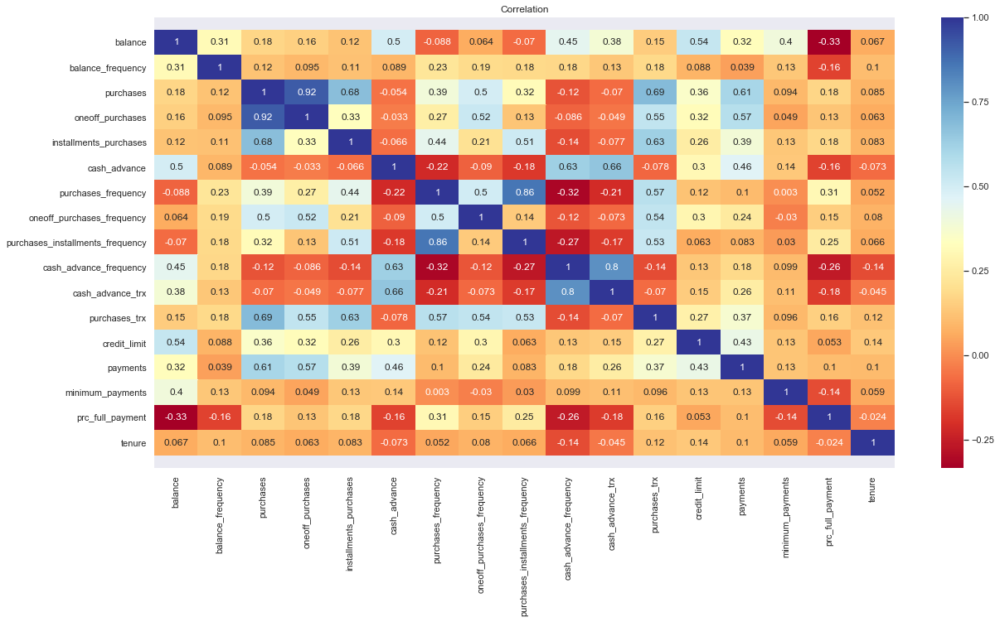

In [0]:
# View Feature correlation
plt.figure(figsize=(20,10))
ax = sns.heatmap(df.corr(), cmap='RdYlBu', annot=True)
bottom, top = ax.get_ylim()
ax.set_ylim(bottom + 0.5, top - 0.5)
plt.title('Correlation')

plt.show()

The initial impression from the correlation indicates data are not highly dimensional nor, as a whole, strongly correlated.  Given the low dimensionality of the data, an initial thought is that dimensionality reduction techniques, while useful for visualizing data clusters, may not be necessary for cluster modeling.

Strong correlations are noted between features with common descriptors (i.e. "purchases").  These correlations make sense given they represent either encompassing data or specific pieces of the encompassing data.  PCA may be a useful tool in these instances.  

Consideration should be given the overall near neutral correlation between features.  Given this may indicate nonlinearity, PCA may be an inadequate resource for both visualization and modeling of data. 


In [0]:
# Subset data for exploration
activities = df[['balance_frequency', 'purchases_frequency', 'oneoff_purchases_frequency',
                 'purchases_installments_frequency', 'cash_advance_frequency', 'balance', 
                 'credit_limit']]

purchases = df[['purchases', 'oneoff_purchases', 'installments_purchases',
                'balance', 'credit_limit']]

payments = df[['credit_limit', 'payments', 'minimum_payments', 'prc_full_payment', 'balance', 
               'purchases']]



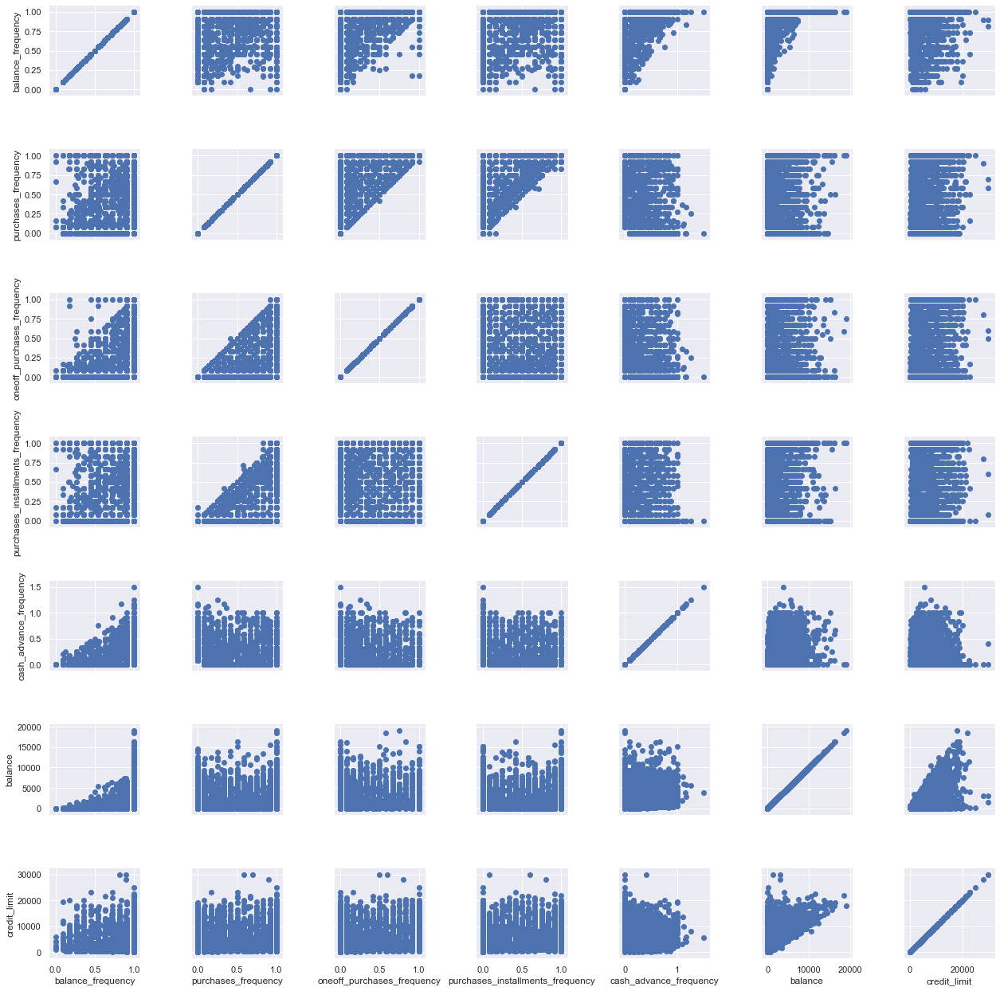

In [0]:
grid = sns.PairGrid(activities)
grid = grid.map(plt.scatter)
plt.show()

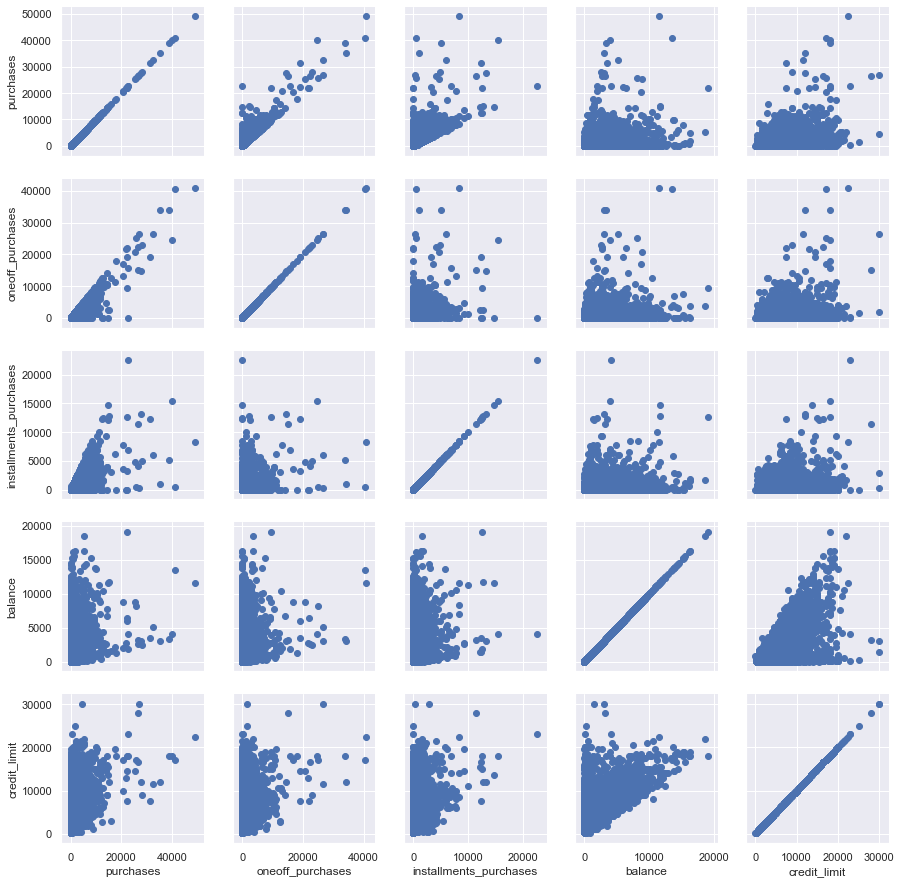

In [0]:
grid = sns.PairGrid(purchases)
grid = grid.map(plt.scatter)
plt.show()

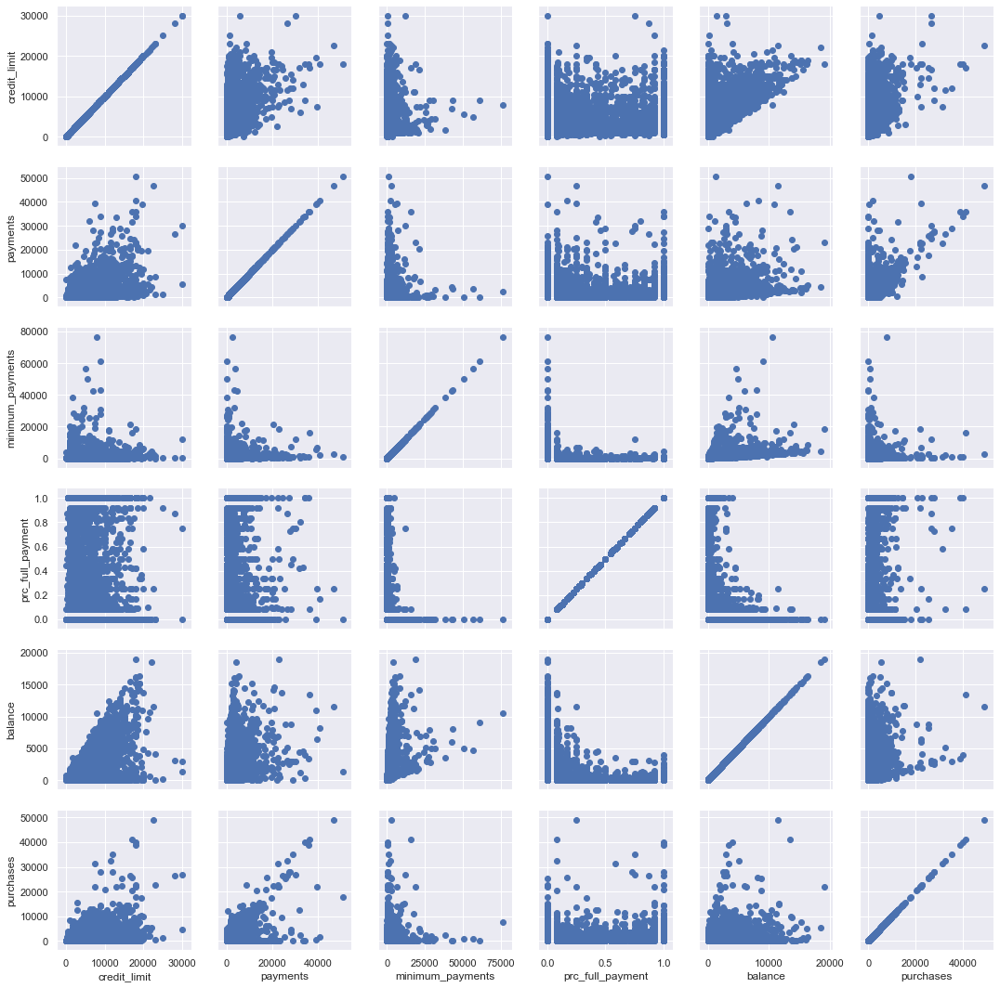

In [0]:
grid = sns.PairGrid(payments)
grid = grid.map(plt.scatter)
plt.show()

As seen in the plots above, features with strong correlation also tend to approximate and/or demonstrate linear relationships.  Additionally, features showing near neutral correlation also tend to show no easily discernible linear relationship.  The mixture of linear and nonlinear data may indicate difficulty with PCA explaining the data both visually and with a model.

Some additional value may be extracted through feature engineering.

### Feature Engineering



In [0]:
# Calculate ratio features
df['cash_per_trx'] = df['cash_advance'] / df['cash_advance_trx']
df['purchases_per_trx'] = df['purchases'] / df['purchases_trx']
df['balance_to_limit_ratio'] = df['balance'] / df['credit_limit']
df['purchases_to_payment_ratio'] = df['purchases'] / df['payments']
df['cash_to_payment'] = df['cash_advance'] / df['payments']

In [0]:
# Account for denominators of zero
df = df.replace([np.inf, -np.inf], np.nan).fillna(0)


In [0]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 8636 entries, 0 to 8949
Data columns (total 22 columns):
balance                             8636 non-null float64
balance_frequency                   8636 non-null float64
purchases                           8636 non-null float64
oneoff_purchases                    8636 non-null float64
installments_purchases              8636 non-null float64
cash_advance                        8636 non-null float64
purchases_frequency                 8636 non-null float64
oneoff_purchases_frequency          8636 non-null float64
purchases_installments_frequency    8636 non-null float64
cash_advance_frequency              8636 non-null float64
cash_advance_trx                    8636 non-null int64
purchases_trx                       8636 non-null int64
credit_limit                        8636 non-null float64
payments                            8636 non-null float64
minimum_payments                    8636 non-null float64
prc_full_payment           

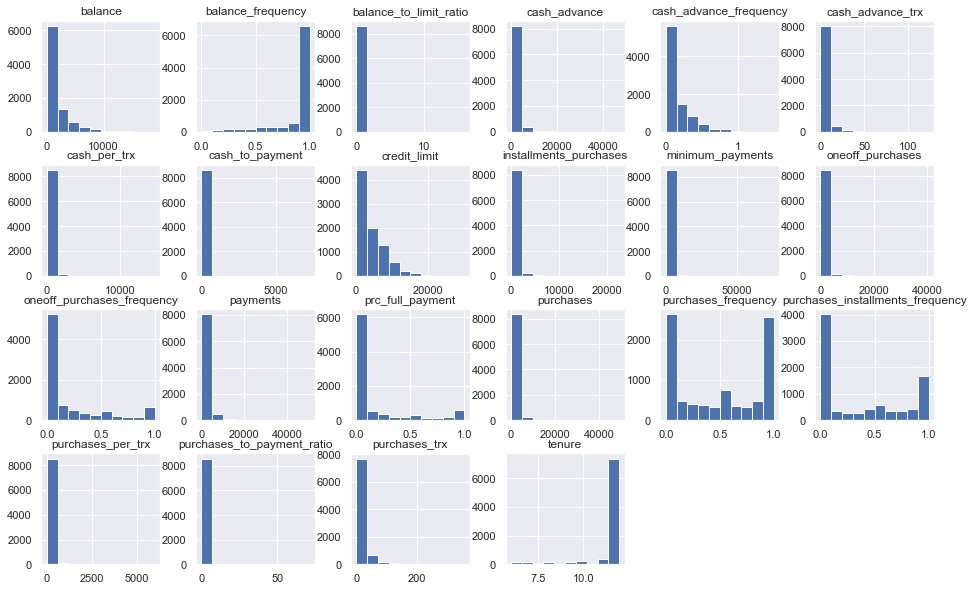

In [0]:
# plot histogram of features
df.hist(figsize=(16,10), layout=(4,6),)
plt.show()

In [0]:
caf = df[df['cash_advance_frequency']>1].sum()

caf.shape

(22,)

Contrary to the meta-data description, the range for the 'cash_advance_frequency' extends beyond the expected 0<>1 range. Handling of 'cash_advance_frequency' data is necessary to ensure it is consistent with the meta-data description. 

In [0]:
# Replace all values >1 with 1
df['cash_advance_frequency'] = [1 if x > 1 else x for x in df['cash_advance_frequency']]

### Transform Data

In [0]:
# Initialize dataframe for transformed data:  X
X = pd.DataFrame()

# Specify transformation methods per column
transformations = {'balance':np.log1p(df['balance']), 
                   'balance_frequency':df['balance_frequency'], 
                   'purchases':np.log1p(df['purchases']),
                   'oneoff_purchases':np.log1p(df['oneoff_purchases']), 
                   'installments_purchases':np.log1p(df['installments_purchases']), 
                   'cash_advance':np.log1p(df['cash_advance']), 
                   'purchases_frequency':df['purchases_frequency'], 
                   'oneoff_purchases_frequency':df['oneoff_purchases_frequency'], 
                   'purchases_installments_frequency':df['purchases_installments_frequency'], 
                   'cash_advance_frequency':df['cash_advance_frequency'], 
                   'cash_advance_trx':np.log1p(df['cash_advance_trx']), 
                   'purchases_trx':np.log1p(df['purchases_trx']), 
                   'credit_limit':np.log1p(df['credit_limit']), 
                   'payments':np.log1p(df['payments']), 
                   'minimum_payments':np.log1p(df['minimum_payments']), 
                   'prc_full_payment':np.sqrt(df['prc_full_payment']), 
                   'tenure':df['tenure'],
                   'cash_per_trx':np.log1p(df['cash_per_trx']),
                   'cash_to_payment':np.log1p(df['cash_to_payment']),
                   'purchases_per_trx':np.log1p(df['purchases_per_trx']),
                   'balance_to_limit_ratio':np.log1p(df['balance_to_limit_ratio']),
                   'purchases_to_payment_ratio':np.log1p(df['purchases_to_payment_ratio'])}

# Create transformed dataframe
for column in df.columns:
    X[column] = transformations.get(column)

In [0]:
# Initialize Scaler
scaler = StandardScaler()

# Scale data 
sc_X = scaler.fit_transform(X)

# normalize data
nm_X = pd.DataFrame(normalize(sc_X))



## Clustering with PCA

In [0]:
# Transform into components: 2 components for plotting
pca = PCA(n_components=2)

pca_X = pca.fit_transform(nm_X)

In [0]:
# preserve column names for later
cols = df.columns

# dataframe to save component data
dim_red = pd.DataFrame()

dim_red['p1'] = [c[0] for c in pca_X]
dim_red['p2'] = [c[1] for c in pca_X]

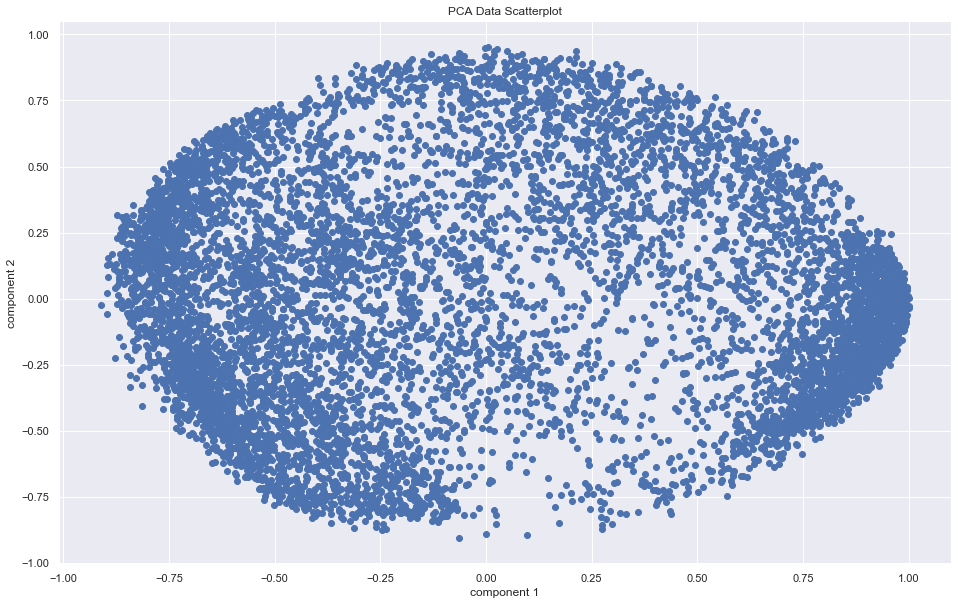

In [0]:
# Plot for intuition
plt.figure(figsize=(16,10))
plt.scatter(dim_red['p1'], dim_red['p2'])
plt.title('PCA Data Scatterplot')
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.show()

Without labels, the initial impression of this plot would indicate a degree of "polarity"; densely concentrated data at opposite ends.  While the plot shows areas of high data density, no discernible clusters are seen.  

### How Many Clusters?

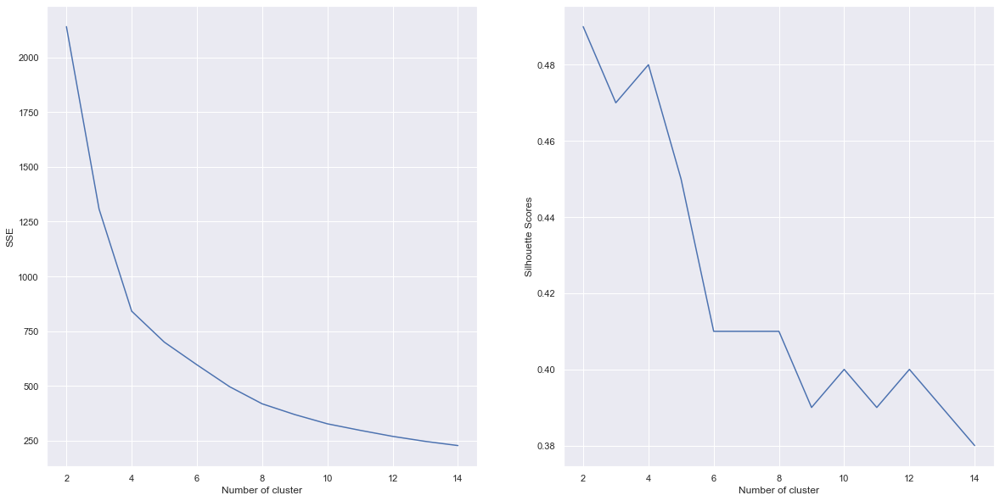

In [0]:
# Initialize dictionaries to store cluster data 
sse = {}
ssc = {}

for k in range(2, 15):
    model = KMeans(n_clusters=k, max_iter=1000)
    clusters = model.fit_predict(pca_X)
    s_score = silhouette_score(pca_X, clusters)
    X['clusters'] = model.labels_
    X['s_scores'] = s_score
    sse[k] = (model.inertia_)
    ssc[k] = round(s_score, 2)


plt.figure(figsize=(20, 10))
plt.subplot(121)
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")

plt.subplot(122)
plt.plot(list(ssc.keys()), list(ssc.values()))
plt.xlabel("Number of cluster")
plt.ylabel("Silhouette Scores")
plt.show()

In [0]:
for x in range(2,15):
    print(f'Inertia for {x} clusters: {sse.get(x)}')
    print(f'Silhouette for {x} clusters: {ssc.get(x)}')
    print('')

Inertia for 2 clusters: 2140.6859362098885
Silhouette for 2 clusters: 0.49

Inertia for 3 clusters: 1307.6160832678124
Silhouette for 3 clusters: 0.47

Inertia for 4 clusters: 841.0583075488352
Silhouette for 4 clusters: 0.48

Inertia for 5 clusters: 699.7292662275498
Silhouette for 5 clusters: 0.45

Inertia for 6 clusters: 596.1996189692844
Silhouette for 6 clusters: 0.41

Inertia for 7 clusters: 496.3234689783743
Silhouette for 7 clusters: 0.41

Inertia for 8 clusters: 418.01268028464614
Silhouette for 8 clusters: 0.41

Inertia for 9 clusters: 368.86166534763566
Silhouette for 9 clusters: 0.39

Inertia for 10 clusters: 326.63791783537613
Silhouette for 10 clusters: 0.4

Inertia for 11 clusters: 297.00062095481746
Silhouette for 11 clusters: 0.39

Inertia for 12 clusters: 269.34275079542186
Silhouette for 12 clusters: 0.4

Inertia for 13 clusters: 246.46790801128185
Silhouette for 13 clusters: 0.39

Inertia for 14 clusters: 227.3517776169419
Silhouette for 14 clusters: 0.38



In [0]:
# calculate linkage
p_links = linkage(pca_X, method='ward')

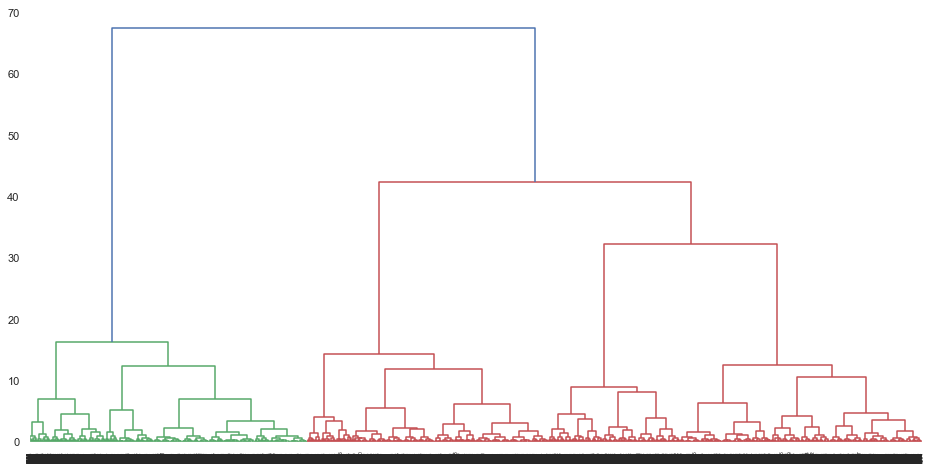

In [0]:
# plot initial dentrogram
plt.figure(figsize=(16,8))
dendrogram(p_links)
plt.show()

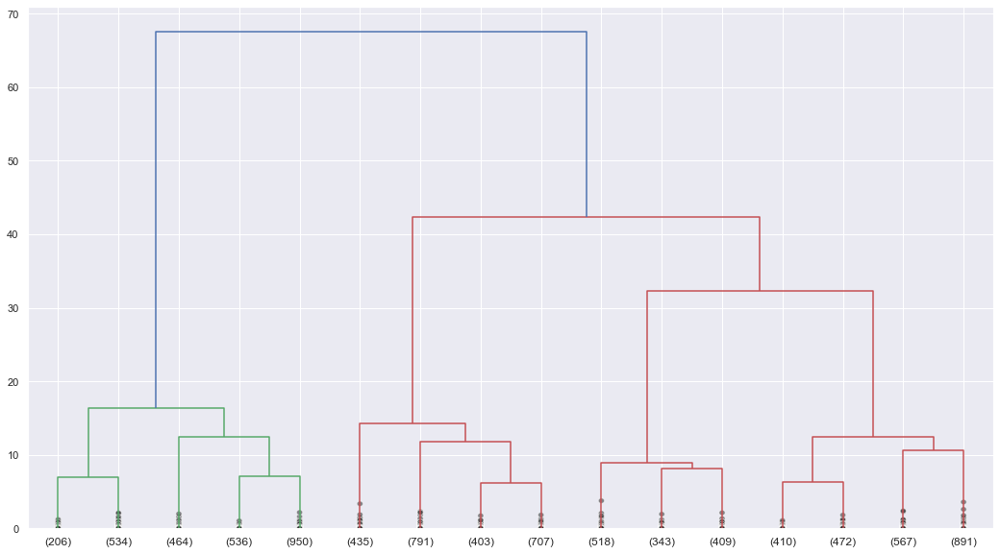

In [0]:
plt.figure(figsize=(18,10))
dendrogram(p_links, truncate_mode="lastp", p = 16, show_leaf_counts= True, 
                  show_contracted= True) 

plt.show()

A notable initial impression is the similarity of shape observed in silhouette plot and elbow plot. In both plots, as the number of potential clusters increases, the lesser the ability to "explain" variance.  In other words, distinguishing the clusters from each other becomes more difficult as the number of clusters increases.  Based on the plot of inertia, the associated elbow suggests the ideal number of plots is four.  

The silhouette score, on the other hand, indicates an ideal number of clusters is small; two. While two clusters may not be a useful outcome, it could be an accurate one and, therefore, should be explored.  Additionally, the spike at four clusters is consistent with the elbow plot.

Finally, the dendrogram plots allow for evaluation of linkage closeness.  Moving from top to bottom, the closeness of clusters (vertical line length between levels of "splitting") appears greatest at the two and four cluster levels.  This is consistent with the elbow and silhouette plots. 

Having determined that data may be clustered into either two or four clusters, pca reduced data will be applied to K-Means, Gaussian, and Agglomerative models for evaluation and comparison.  

### K-Means

#### 2 Clusters

For n_clusters = 2 The average silhouette_score is : 0.48823032003135597


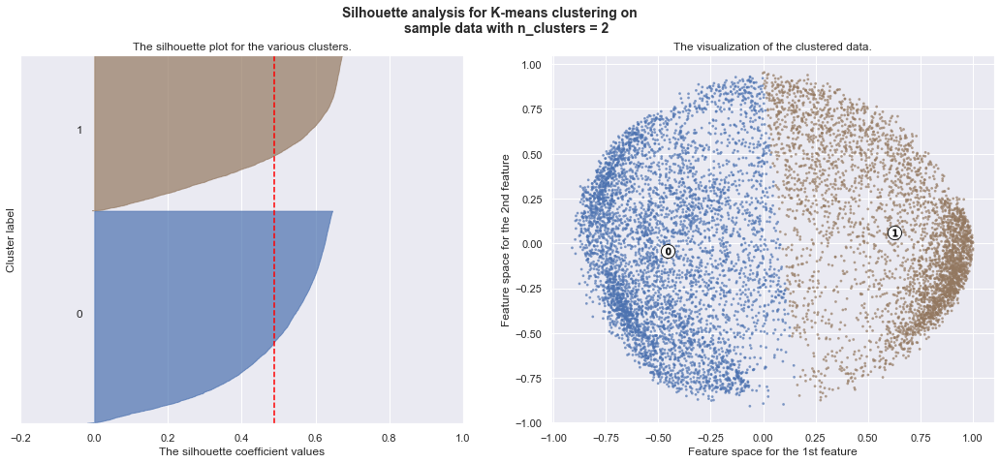

In [0]:
silhouette_plot(pca_X,_,[2], limiter=[-0.2,1])

#### 4 Clusters

For n_clusters = 4 The average silhouette_score is : 0.4790194316527554


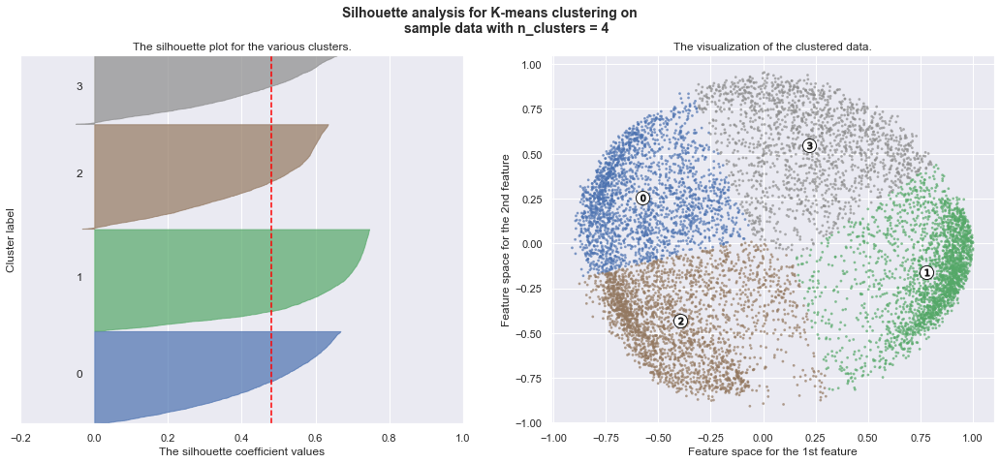

In [0]:
silhouette_plot(pca_X,_,[4], limiter=[-0.2,1])

### Gaussian Mixture

#### 2 Clusters

For n_clusters = 2 The average silhouette_score is : 0.4844301102582187


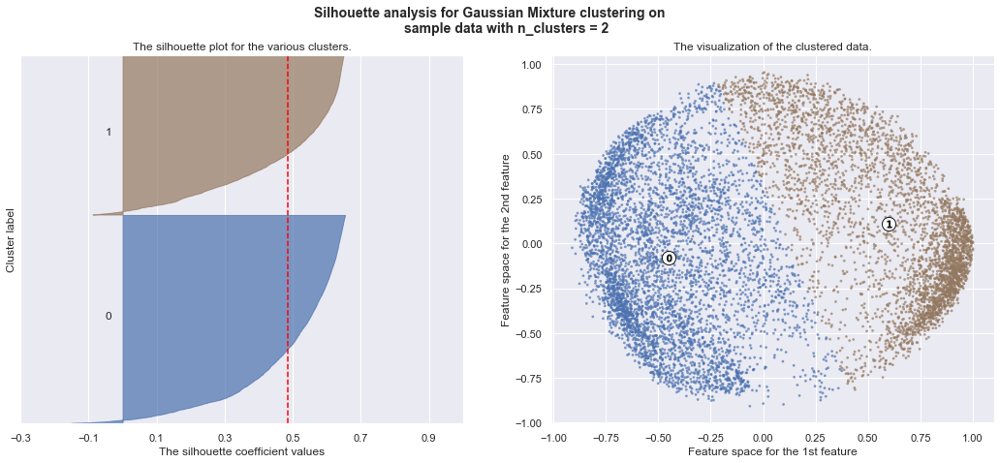

In [0]:
silhouette_plot(pca_X,_,[2], limiter=[-0.3,1], model='gaussian')

#### 4 Clusters

For n_clusters = 4 The average silhouette_score is : 0.4391199923008376


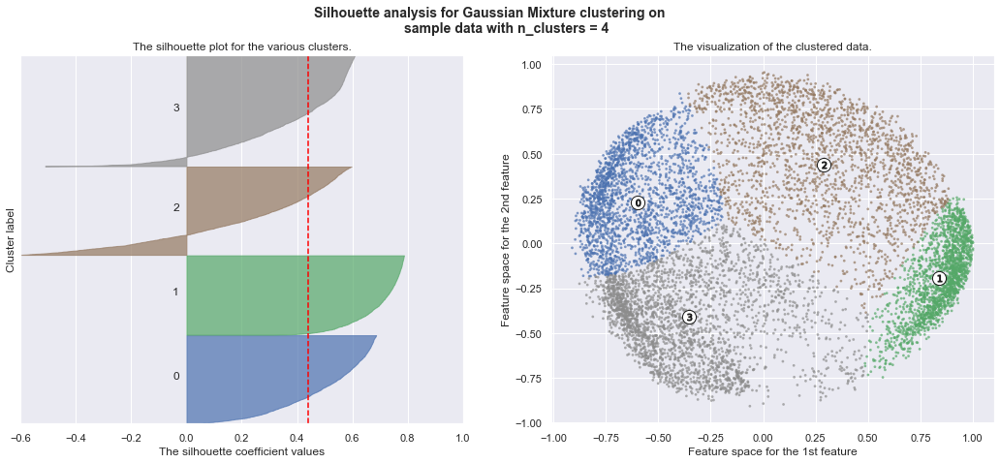

In [0]:
silhouette_plot(pca_X,_,[4], limiter=[-0.6,1], model='gaussian')

### Hierarchical/Agglomerative

#### 2 Clusters

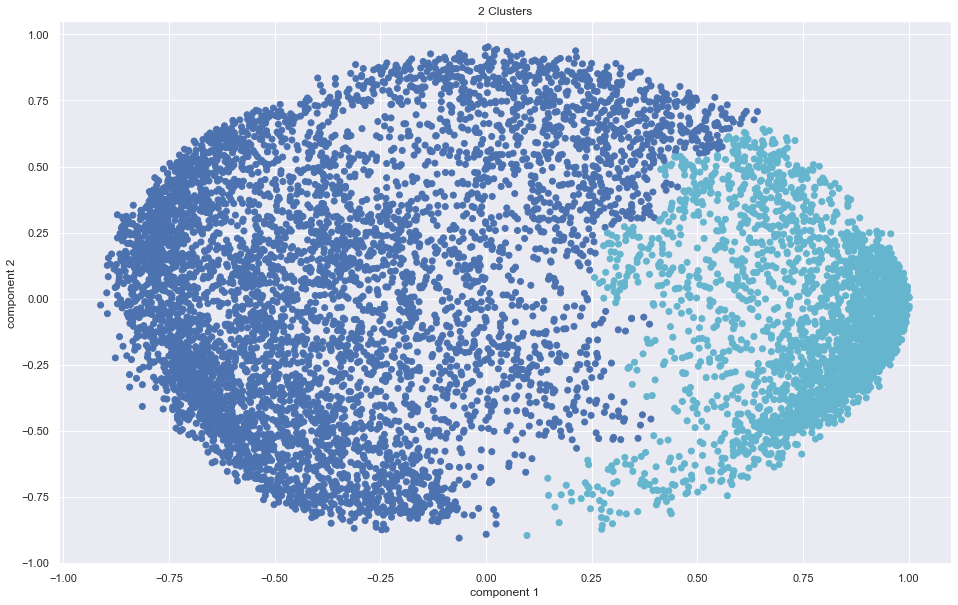

In [0]:
plt.figure(figsize=(16,10))
plt.title('2 Clusters')
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.scatter(dim_red['p1'], dim_red['p2'], 
            c=AgglomerativeClustering(n_clusters=2, affinity='euclidean', 
                                      linkage='ward').fit_predict(pca_X),
           cmap=cmap) 

plt.show()

#### 4 Clusters

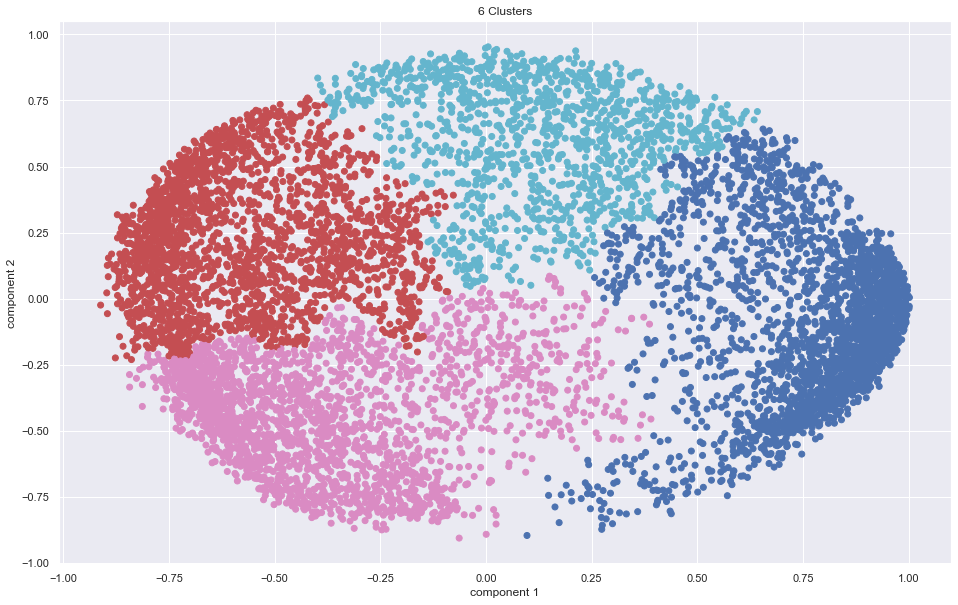

In [0]:
plt.figure(figsize=(16,10))
plt.title('6 Clusters')
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.scatter(dim_red['p1'], dim_red['p2'], 
            c=AgglomerativeClustering(n_clusters=4, affinity='euclidean', 
                                      linkage='ward').fit_predict(pca_X), 
            cmap=cmap) 

plt.show()

In [0]:
pca.explained_variance_ratio_

array([0.35390927, 0.18289582])

## Clustering with UMAP

The initial impression of the PCA data plot shows separation that might be intuitively considered clusters.  Attempts to model the data, however, demonstrate identified clusters do not visually appear intuitive nor reasonable.  Moreover, clusters appear noisy and difficult to visually interpret.  This is likely because the first two components of PCA explain only about 56% of the variance of the data.  

The 44% loss of ability to explain data is most likely due to the mixture of linear and nonlinear features. Consequently, the resulting loss is demonstrated as noise through visualization and may likely impact the model as well.  To handle the nonlinearity of the model, UMAP will be applied.  UMAP is a dimensionality reduction method that is able to handle nonlinear data, preserve similarity, and better demonstrate dissimilarity.  Exploration of previously used models will be performed after applying UMAP dimensionality reduction techniques.

In [0]:
umap_X = umap.UMAP(random_state=42, n_neighbors=75, min_dist=.5, metric='euclidean',).fit_transform(X)

In [0]:
dim_red['u1'] = [x[0] for x in umap_X]
dim_red['u2'] = [x[1] for x in umap_X]



In [0]:
# Save pca/umap components to dimensions_reduced.csv for reference  
#dim_red.to_csv('data/dimensions_reduced.csv')

# Read saved dimensionality reduced data
dim_red = pd.read_csv('data/dimensions_reduced_maybe.csv')

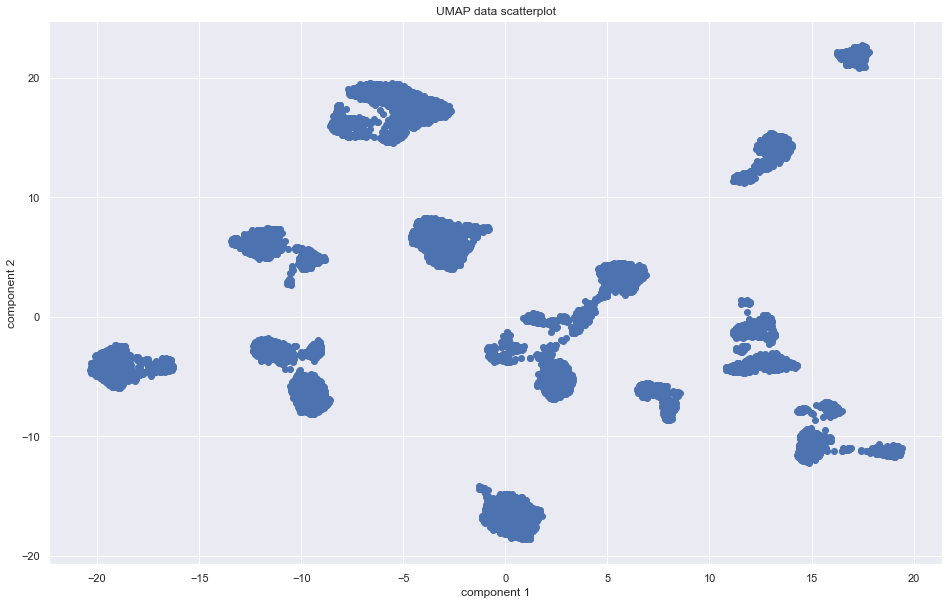

In [0]:
plt.figure(figsize=(16,10))
plt.title('UMAP data scatterplot')
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.scatter(dim_red['u1'], dim_red['u2']) 

plt.show()

The plot shows density concentrations that intuitively suggests more than 20 potential clusters or cluster groups.  Even within the potentially discernible clusters, additional separation appears to exist--which might indicate more clusters.  Without labels or color mapping, it would be difficult to identify separate clusters.  

An earlier consideration was determining usefulness of a potentially small number of clusters.  Likewise, a determination of the usefulness of a large number of clusters must be considered. Whereas a small number of clusters may provide overly generalized information, a large number of distinct clusters may begin to provide overly specific information.  Identifying an appropriate balance between generality and specificity is ideal.

### How Many Clusters?


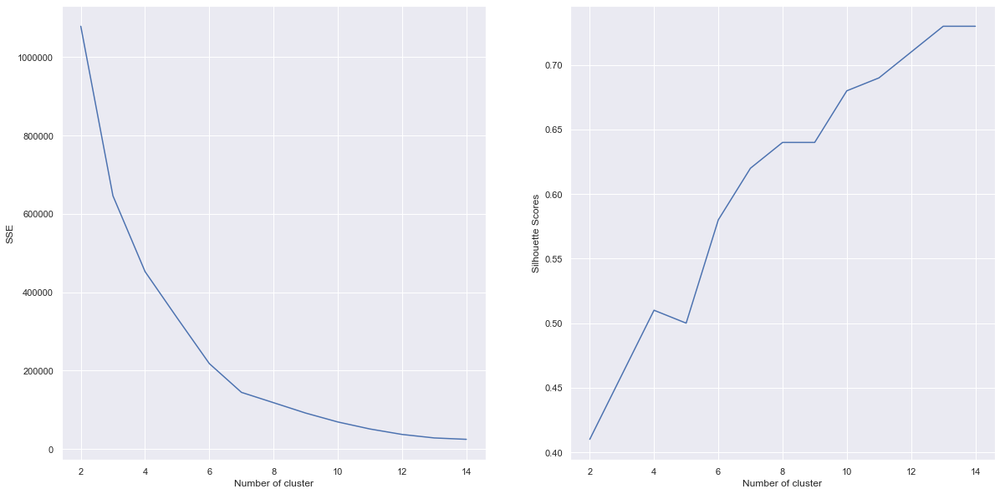

In [0]:
sse = {}
ssc = {}

for k in range(2, 15):
    model = KMeans(n_clusters=k, max_iter=1000, random_state=42)
    clusters = model.fit_predict(dim_red[['u1', 'u2']].values)
    s_score = silhouette_score(dim_red[['u1', 'u2']].values, clusters)
    X['ump_clusters'] = model.labels_
    X['ump_s_scores'] = s_score
    sse[k] = (model.inertia_)
    ssc[k] = round(s_score, 2)


plt.figure(figsize=(20, 10))
plt.subplot(121)
plt.plot(list(sse.keys()), list(sse.values()))
plt.xlabel("Number of cluster")
plt.ylabel("SSE")

plt.subplot(122)
plt.plot(list(ssc.keys()), list(ssc.values()))
plt.xlabel("Number of cluster")
plt.ylabel("Silhouette Scores")
plt.show()

In [0]:
for x in range(2,15):
    print(f'Inertia for {x} clusters: {sse.get(x)}')
    print(f'Silhouette for {x} clusters: {ssc.get(x)}')
    print('')

Inertia for 2 clusters: 1078758.291337322
Silhouette for 2 clusters: 0.41

Inertia for 3 clusters: 646072.8960125287
Silhouette for 3 clusters: 0.46

Inertia for 4 clusters: 452476.52866312145
Silhouette for 4 clusters: 0.51

Inertia for 5 clusters: 334069.8416294885
Silhouette for 5 clusters: 0.5

Inertia for 6 clusters: 217700.51289268056
Silhouette for 6 clusters: 0.58

Inertia for 7 clusters: 144241.2325421689
Silhouette for 7 clusters: 0.62

Inertia for 8 clusters: 117856.82362089978
Silhouette for 8 clusters: 0.64

Inertia for 9 clusters: 91355.17626675313
Silhouette for 9 clusters: 0.64

Inertia for 10 clusters: 68651.32442773772
Silhouette for 10 clusters: 0.68

Inertia for 11 clusters: 50730.19399378085
Silhouette for 11 clusters: 0.69

Inertia for 12 clusters: 36810.668023933875
Silhouette for 12 clusters: 0.71

Inertia for 13 clusters: 27895.909355773834
Silhouette for 13 clusters: 0.73

Inertia for 14 clusters: 24346.21887265747
Silhouette for 14 clusters: 0.73



In [0]:
u_links = linkage(dim_red[['u1', 'u2']].values, method='ward')

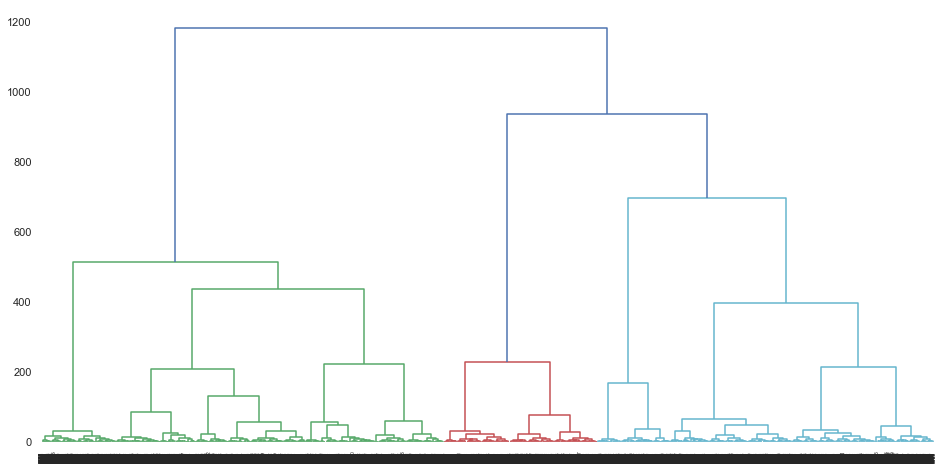

In [0]:
plt.figure(figsize=(16,8))
dendrogram(u_links)
plt.show()

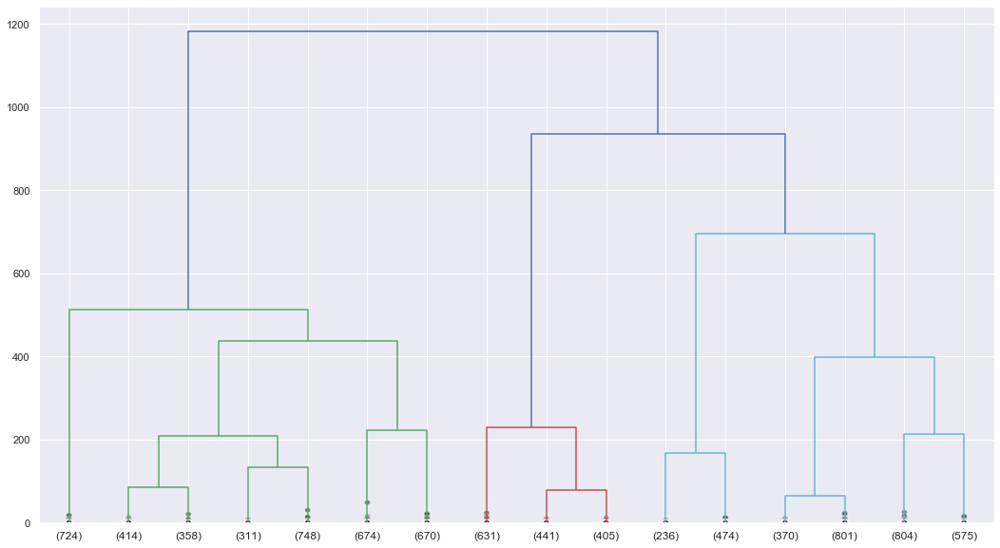

In [0]:
plt.figure(figsize=(18,10))
dendrogram(u_links, truncate_mode="lastp", p = 16, show_leaf_counts= True, 
                  show_contracted= True) 

plt.show()

A notable difference from before is the difference in shape observed between the silhouette plot and elbow plots. The inertia observed in the elbow plot indicates a decrease in explained variance as the number of clusters increases.  A distinct elbow is observed at seven clusters.

Contrarily, the silhouette plot indicates a larger number of distinct clusters can be derived from the data.  While showing a general increase, a slight dip occurs after four clusters; indicating four clusters may be reasonably considered.  Silhouette scores appear to slow at seven clusters and level off at eight and nine clusters before continuing to increase.

Finally, consideration of thresholds of 600 or 300 of the dendrogram plots indicate that either 4 or 7 clusters may be reasonable and should be explored.

At this point, careful consideration of the question of an ideal number of clusters is important.  The usefulness of a few clusters is questionable because a threshold with too few potential targets may be too broad for effective marketing.  On the other hand, the usefulness of many clusters is questionable because too many targets may be too limited for effective marketing.

Having found a range of potential cluster amounts, UMAP reduced data will be applied to K-Means, Gaussian, and Agglomerative models at a specified number of clusters (either four, seven, eight, or nine) for evaluation and comparison.  

### KMeans

#### 4 Clusters

For n_clusters = 4 The average silhouette_score is : 0.5119563560595934


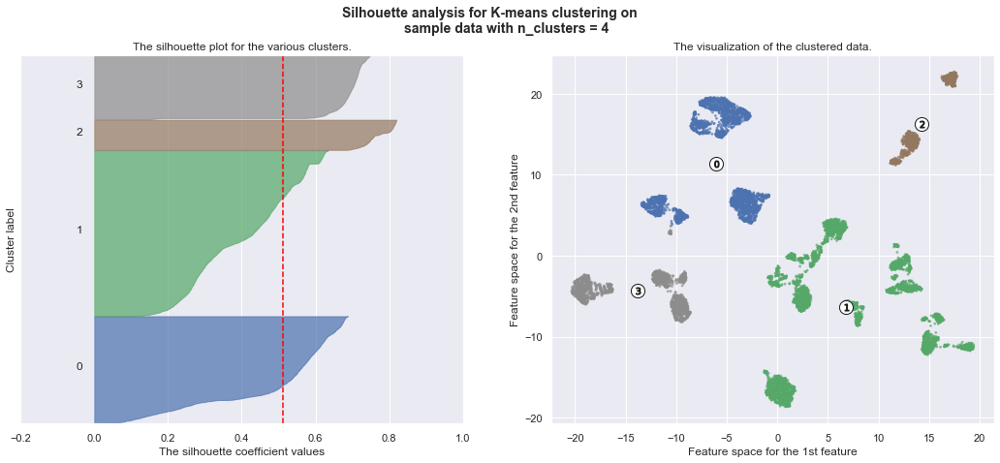

In [0]:
silhouette_plot(dim_red[['u1', 'u2']].values,_,[4], limiter=[-0.2,1])

#### 7 Clusters

For n_clusters = 7 The average silhouette_score is : 0.615192133998021


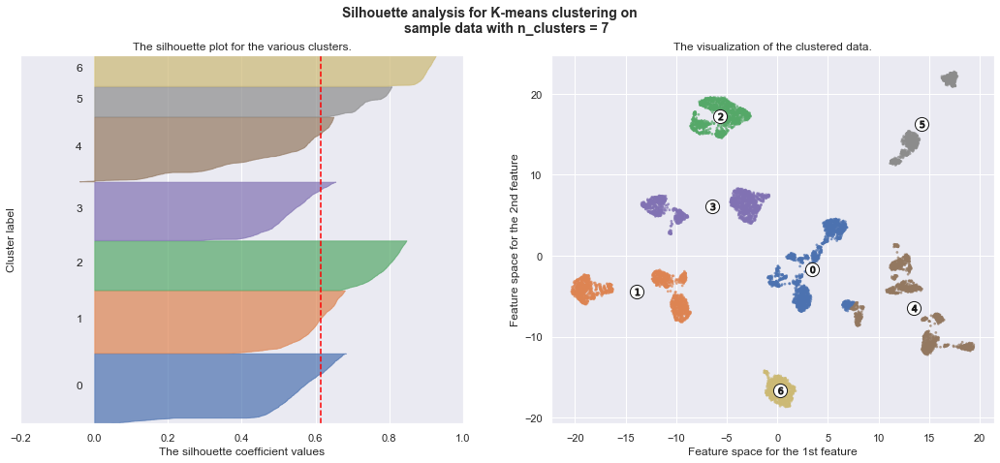

In [0]:
silhouette_plot(dim_red[['u1', 'u2']].values,_,[7], limiter=[-0.2,1])

#### 8 Clusters

For n_clusters = 8 The average silhouette_score is : 0.6362377947183936


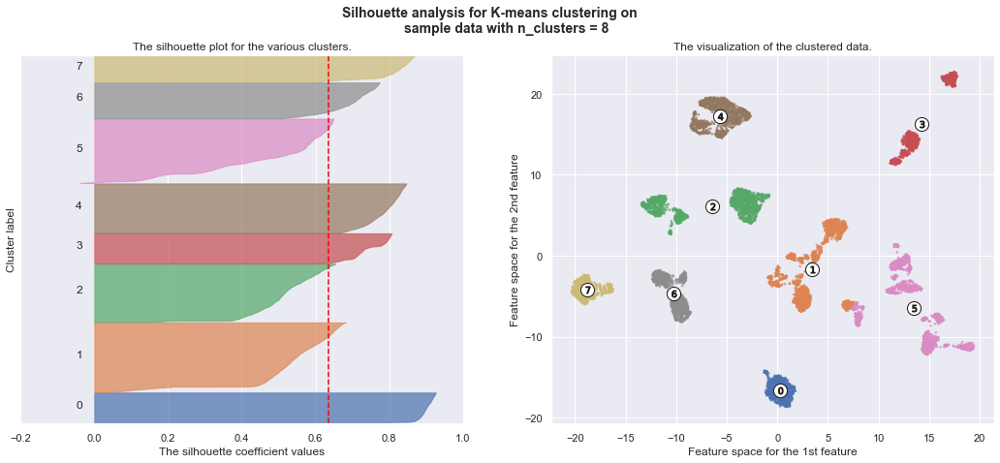

In [0]:
silhouette_plot(dim_red[['u1', 'u2']].values,_,[8], limiter=[-0.2,1])

#### 9 Clusters

For n_clusters = 9 The average silhouette_score is : 0.6446741691079882


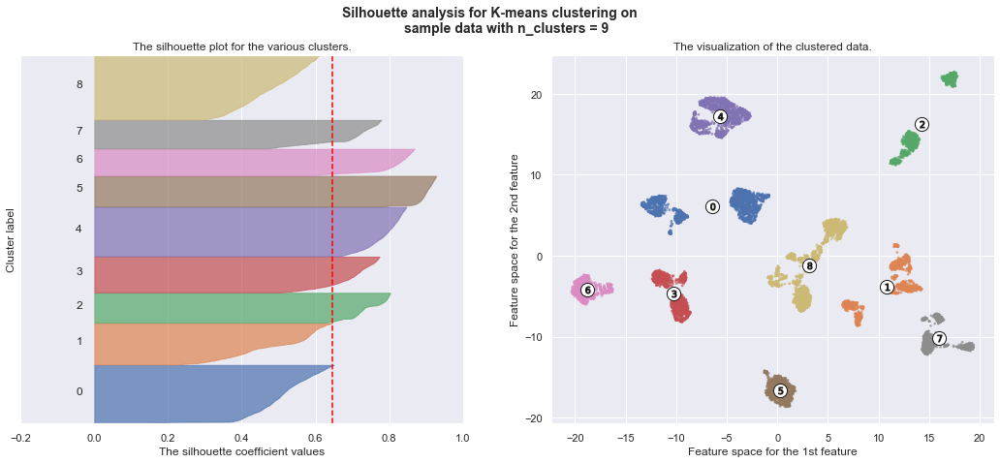

In [0]:
silhouette_plot(dim_red[['u1', 'u2']].values,_,[9], limiter=[-0.2,1])

### Gaussian Mixture

#### 4 Clusters

For n_clusters = 4 The average silhouette_score is : 0.5122117398140581


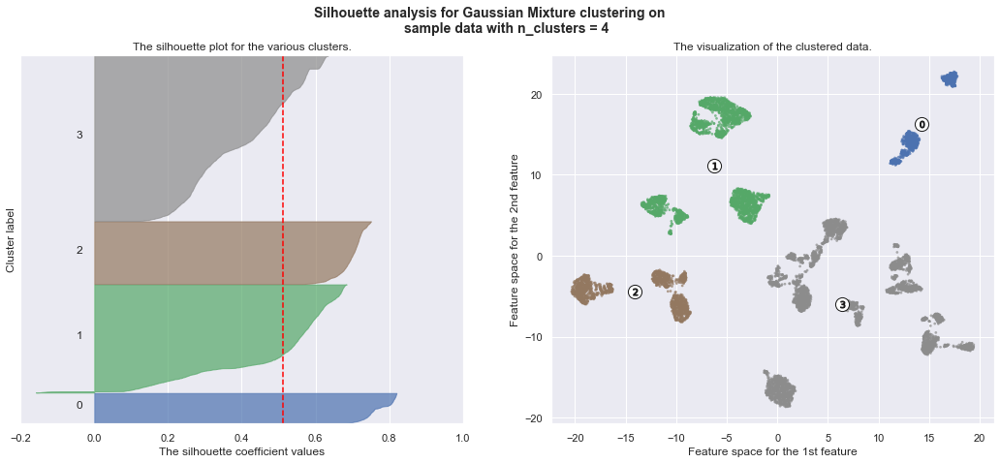

In [0]:
silhouette_plot(dim_red[['u1', 'u2']].values,_,[4], limiter=[-0.2,1], model='gaussian')

#### 7 Clusters

For n_clusters = 7 The average silhouette_score is : 0.6160226954499038


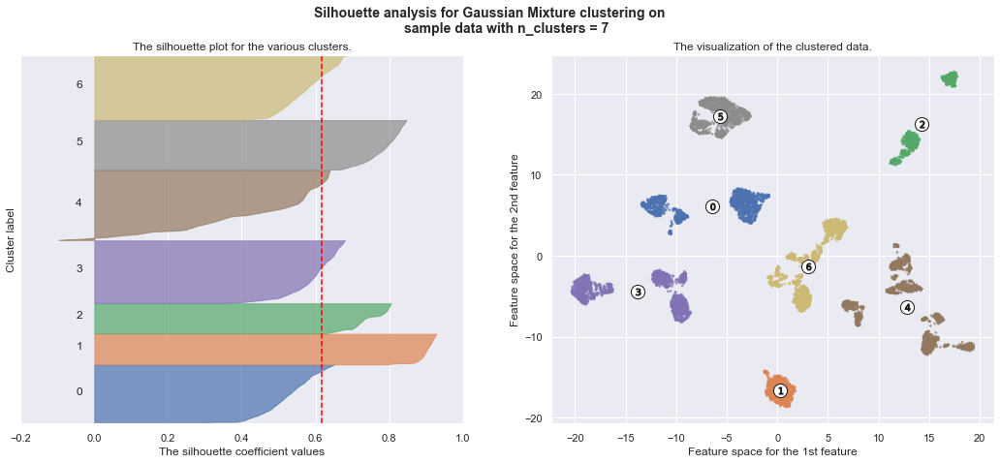

In [0]:
silhouette_plot(dim_red[['u1', 'u2']].values,_,[7], limiter=[-0.2,1], model='gaussian')

#### 8 Clusters

For n_clusters = 8 The average silhouette_score is : 0.6371124136592891


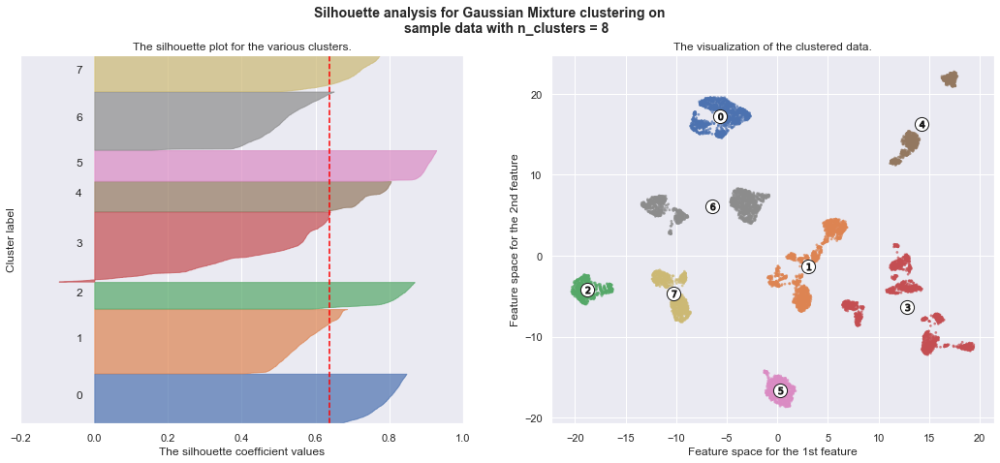

In [0]:
silhouette_plot(dim_red[['u1', 'u2']].values,_,[8], limiter=[-0.2,1], model='gaussian')

#### 9 Clusters

For n_clusters = 9 The average silhouette_score is : 0.6145188606218269


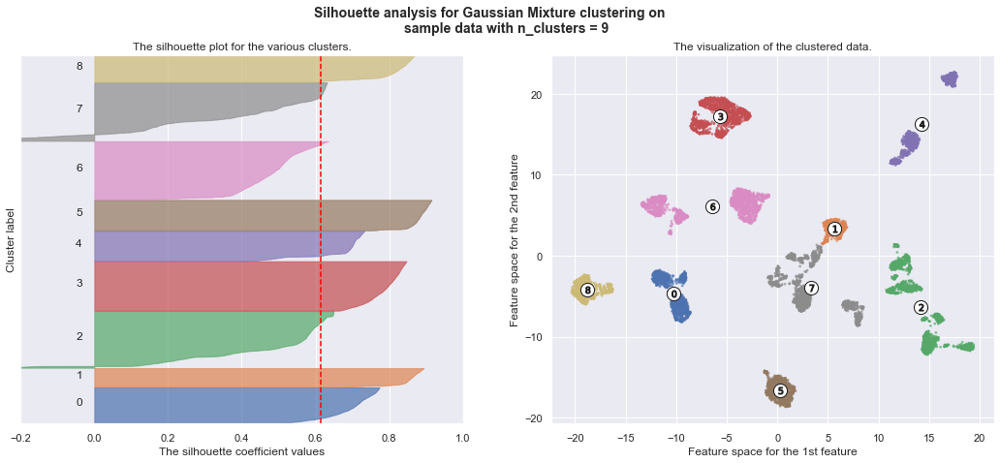

In [0]:
silhouette_plot(dim_red[['u1', 'u2']].values,_,[9], limiter=[-0.2,1], model='gaussian')

### Hierarchical Clustering

#### 4 Clusters

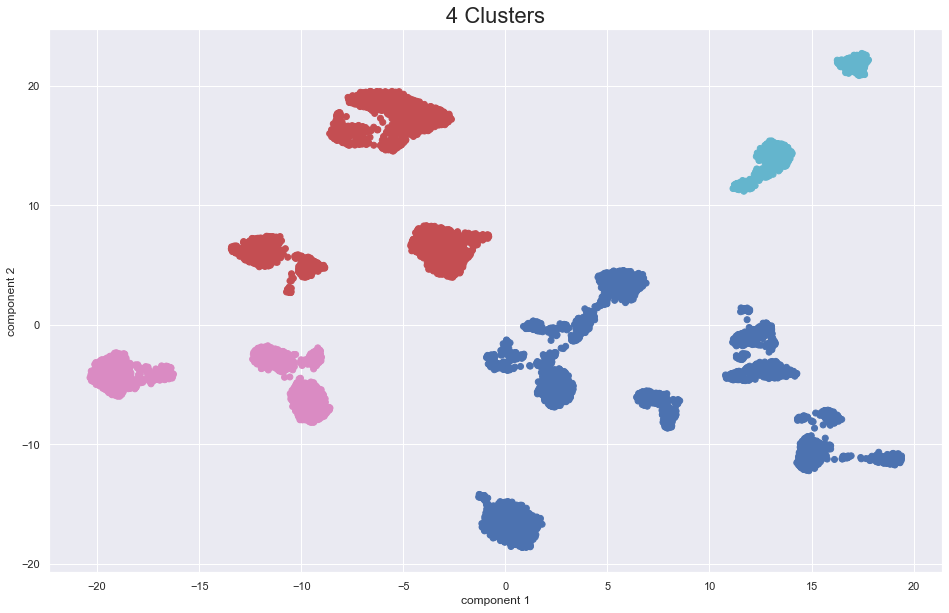

In [0]:
plt.figure(figsize=(16,10))
plt.title('4 Clusters', size=22)
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.scatter(dim_red['u1'], dim_red['u2'], 
            c=AgglomerativeClustering(n_clusters=4, affinity='euclidean', 
                                      linkage='ward').fit_predict(dim_red[['u1', 'u2']].values),
           cmap=cmap) 

plt.show()

#### 7 Clusters

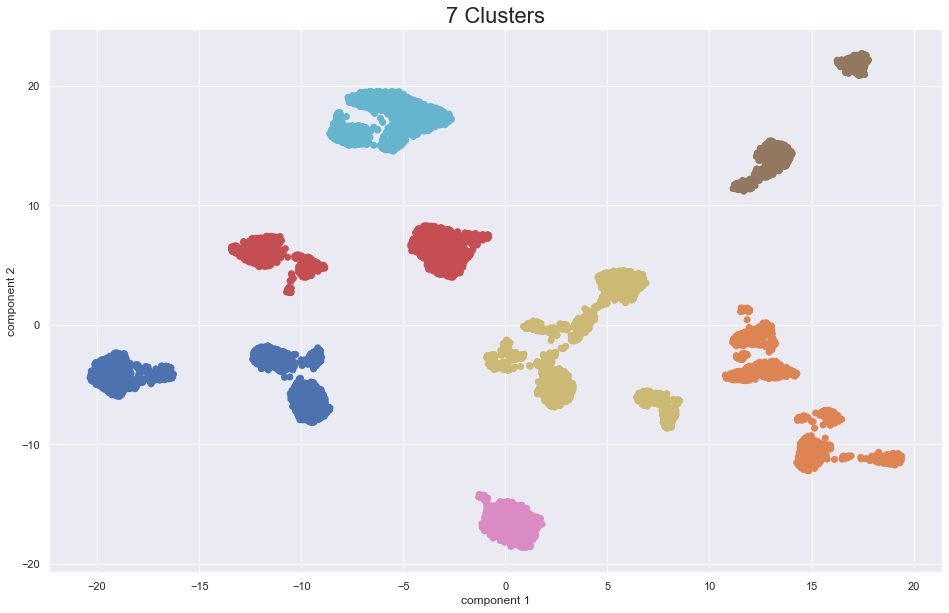

In [0]:
plt.figure(figsize=(16,10))
plt.title('7 Clusters', size=22)
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.scatter(dim_red['u1'], dim_red['u2'], 
            c=AgglomerativeClustering(n_clusters=7, affinity='euclidean', 
                                      linkage='ward').fit_predict(dim_red[['u1', 'u2']].values), 
           cmap=cmap) 

plt.show()

#### 8 Clusters

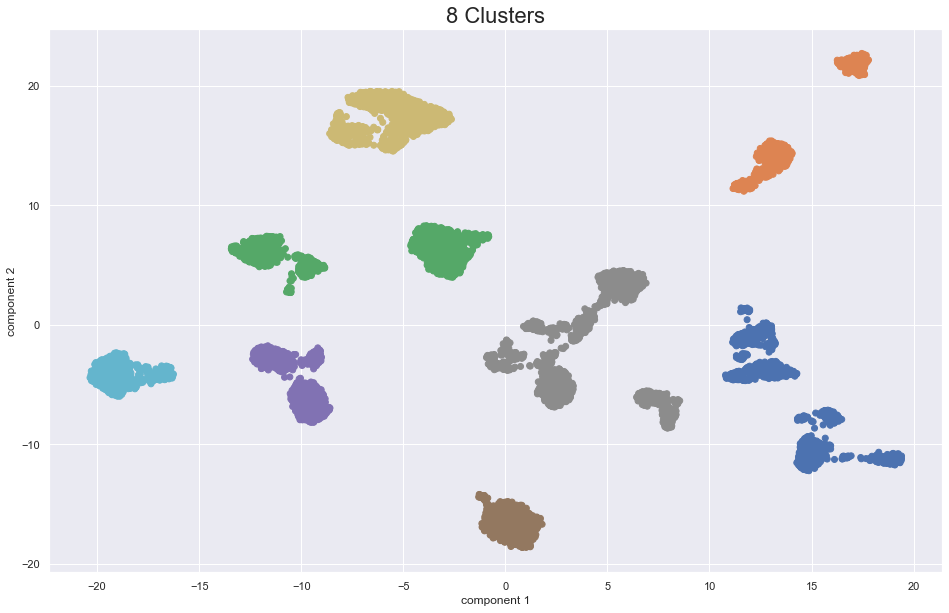

In [0]:
plt.figure(figsize=(16,10))
plt.title('8 Clusters', size=22)
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.scatter(dim_red['u1'], dim_red['u2'], 
            c=AgglomerativeClustering(n_clusters=8, affinity='euclidean', 
                                      linkage='ward').fit_predict(dim_red[['u1', 'u2']].values),
           cmap=cmap) 

plt.show()

#### 9 Clusters

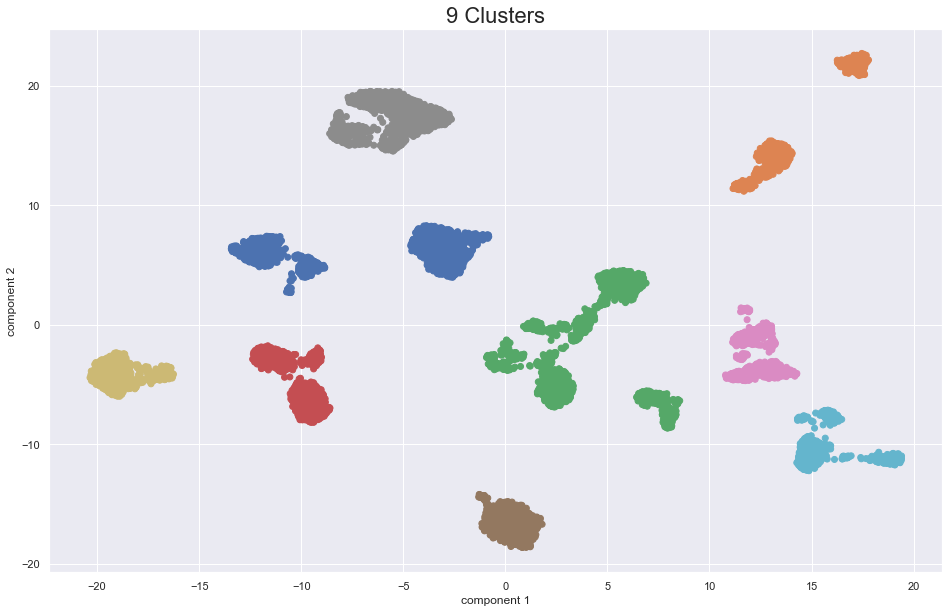

In [0]:
plt.figure(figsize=(16,10))
plt.title('9 Clusters', size=22)
plt.xlabel('component 1')
plt.ylabel('component 2')
plt.scatter(dim_red['u1'], dim_red['u2'], 
            c=AgglomerativeClustering(n_clusters=9, affinity='euclidean', 
                                      linkage='ward').fit_predict(dim_red[['u1', 'u2']].values),
           cmap=cmap) 

plt.show()

## Choosing a Model

Both KMeans And GaussianMixture models performed similarly with eight clusters.  Agglomerative clusters performed well with seven clusters.  Given the shape of the plot, the GaussianMixture model may be better suited than KMeans. 

In [0]:
fcluster()

In [0]:
# Initialize model
model = GaussianMixture(n_components=8, max_iter=1000, random_state=42)

# Fit model to UMAPed data and extract cluster labels
cluster_labels = model.fit_predict(dim_red[['u1', 'u2']].values)

# Apply cluster labels to orginal data for analysis/visualization
df['clusters'] = cluster_labels

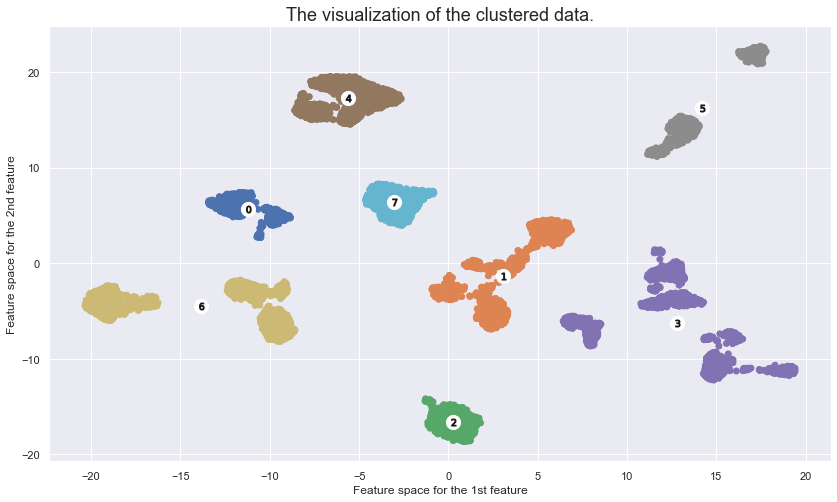

In [0]:
data_clusters(df,'clusters', [dim_red['u1'], dim_red['u2']], model, model_type='gaussian')


## Analyzing Cluster Data

Now that the model has labeled eight clusters of customer behaviors, and labels have been applied to the original data, the next step is to identify the behaviors associated with each cluster.  From there, analysis of gathered insights may yield generalizations allowing for defining distinct customer segments.  

It should be noted that segmentation is not established by identically observed behavior.  The expectation that observed behaviors extracted from specific clusters will overlap with behaviors observed in different clusters is reasonable.  Rather than attempting to classify individual behavior, the focus of this project is finding trends of observed behavior that lend themselves to generalized categorization; or segmentation.  

Guided by this understanding, the focal point for interpreting feature data of each cluster is the central tendency, or observed feature median.  The language of generalization usually refers to the statistical mean when speaking in terms of "average".  That is not the case for this project. Given earlier observations of skewness, the impact of the presence of outliers in feature data render the statistical mean unreliable as a representative descriptor of clusters.  



### Organizing Data for Visualization and Analysis

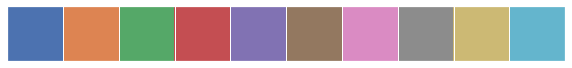

In [0]:
# Reference current color palette
sns.palplot(sns.color_palette())

In [0]:
# Trim & reset color palette for visualization
c_idx = [0, 1, 2, 4, 5, 7, 8, 9]
color_clusters = []

for i,color in enumerate(sns.color_palette()):
    if i in c_idx:
        color_clusters.append(color)
        
sns.set_palette(color_clusters)

In [0]:
# Subset clusters
c0 = df.loc[df['clusters']==0]
c1 = df.loc[df['clusters']==1]
c2 = df.loc[df['clusters']==2]
c3 = df.loc[df['clusters']==3]
c4 = df.loc[df['clusters']==4]
c5 = df.loc[df['clusters']==5]
c6 = df.loc[df['clusters']==6]
c7 = df.loc[df['clusters']==7]

# Organize subsets in a list
# Organize subsets in a list
subsets = {'cluster_0':c0, 'cluster_1':c1, 'cluster_2':c2, 
           'cluster_3':c3, 'cluster_4':c4, 'cluster_5':c5, 
           'cluster_6':c6, 'cluster_7':c7, 'all_data':df}

In [0]:
accounts = ['credit_limit', 'balance', 'balance_to_limit_ratio']

activity = ['balance_frequency', 'purchases_frequency', 'oneoff_purchases_frequency',
            'purchases_installments_frequency', 'cash_advance_frequency']

purchasing = ['purchases', 'purchases_per_trx', 'oneoff_purchases', 'installments_purchases', ]

payments = ['credit_limit', 'payments', 'minimum_payments']

payments2 = ['minimum_payments']

trx = ['purchases_per_trx']

ratios = ['balance_to_limit_ratio', 'purchases_to_payment_ratio', 
          'prc_full_payment', 'cash_to_payment']

transactions = ['purchases_trx', 'purchases_per_trx', 'cash_advance_trx', 
                'cash_per_trx']

clusters = ['Visualization of Clustered data', 'clusters', dim_red, 'u1', 'u2', model, 'gaussian']

### Tools

As discussed earlier, the attempt to quantify behavior, and subsequently categorize/label profiles, consideration must be given to two questions:

* <strong>What tools are available for use?</strong>
* <strong>How are the tools used? </strong>

Reviewing the first question requires identifying relevant features.  In this case, 'credit_limit', 'balance', and the engineered 'balance_to_limit_ratio' are features that identify the tools, or resources, at the customers' disposal.  

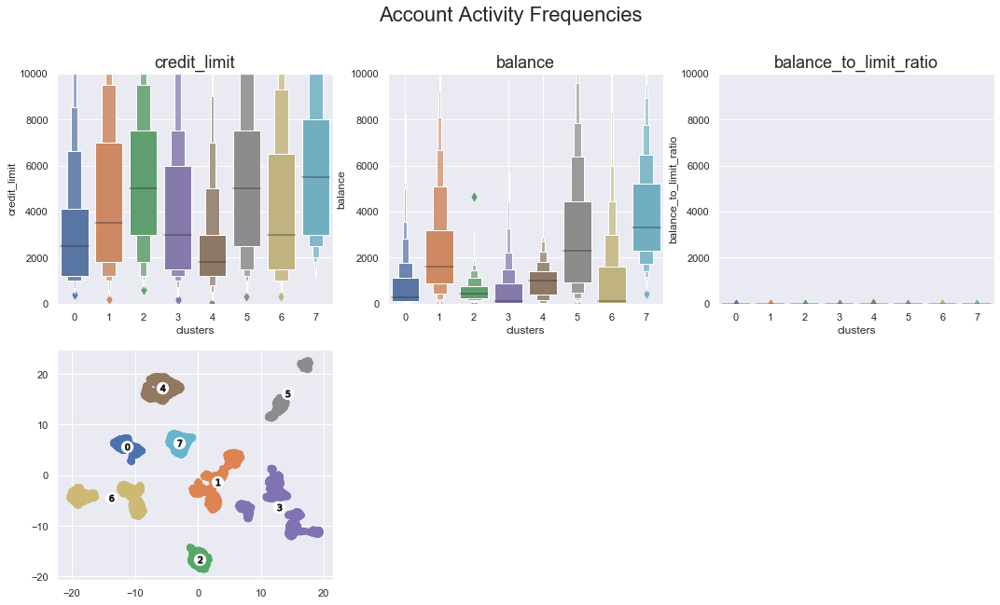

In [0]:
segment_analysis_plots(df, accounts, 'clusters', 'Account Activity Frequencies', 
                       clusters=clusters, yax=[10000,0])

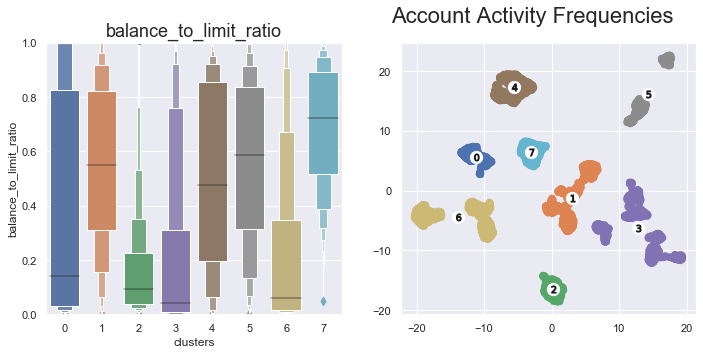

In [0]:
segment_analysis_plots(df, ['balance_to_limit_ratio'], 'clusters', 'Account Activity Frequencies', 
                       clusters=clusters, yax=[1,0])

In [0]:
# Compare distribution shapes of clusters by feature.
features_distributions_grid(subsets, accounts)

,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
idx,,,,,,,,,
count,575,1520,724,1655,1171,710,1477,804,8636
plot_1: credit_limit (mean/median),"(3392.43, 2500.0)","(4879.92, 3500.0)","(5677.74, 5000.0)","(4014.33, 3000.0)","(2675.42, 1800.0)","(5640.23, 5000.0)","(4679.61, 3000.0)","(6070.9, 5500.0)","(4522.09, 3000.0)"
plot_2: balance (mean/median),"(829.43, 274.31)","(2405.63, 1625.18)","(568.05, 419.58)","(612.74, 124.12)","(1053.53, 990.92)","(3074.74, 2284.96)","(1163.56, 130.84)","(3898.03, 3302.58)","(1601.22, 916.86)"
plot_3: balance_to_limit_ratio (mean/median),"(0.38, 0.14)","(0.55, 0.55)","(0.17, 0.09)","(0.22, 0.04)","(0.52, 0.48)","(0.56, 0.59)","(0.23, 0.06)","(0.69, 0.72)","(0.4, 0.32)"


Given the general shape of each distribution is similar, median values (central tendency) can be compared (pair-wise) with a Mann-Whitney-U test.  Whereas this project is one of segmentation (i.e. identifying cluster differences), the alternate hypothesis is that clusters are of separate distributions.  Consequently, the null hypothesis that will be tested is the presumption that data are from the same distribution.  

Given terms of "average" are used for differentiation, an alpha value of 0.05 is reasonable.  Pairwise testing will be performed and p-values will be reported with respect to tested pairs.  Significant results (p-values greater than 0.05) indicate that the null hypothesis cannot be rejected.

A point to consider is that testing of singular features may not provide enough evidence to initially reject the null hypothesis.  But the presumption of the null hypothesis only extends to the feature(s) tested.  Such results are expected, as statistically significant differentiation, if present, may likely occur on a different hyperplane.

In [0]:
# By each cluster:  General statistics and 
# pair-wise Mann-Whitney-U p-values. 
clusters_stats_tests(subsets, 'credit_limit', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,3392.435,4879.917,5677.737,4014.329,2675.42,5640.227,4679.607,6070.896,4522.091
2,median,2500.0,3500.0,5000.0,3000.0,1800.0,5000.0,3000.0,5500.0,3000.0
3,std,3107.541,3854.651,3596.399,3368.467,2412.983,3883.866,3992.699,3364.405,3659.029
4,cluster_0,0.49996,0.0,0.0,0.0,6e-05,0.0,0.0,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.00538,0.0,0.00035
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.16589,0.0,0.00223,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,7e-05,0.0,0.0
8,cluster_4,6e-05,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0
9,cluster_5,0.0,0.0,0.16589,0.0,0.0,0.49997,0.0,9e-05,0.0


In [0]:
clusters_stats_tests(subsets, 'balance', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,829.426,2405.628,568.047,612.744,1053.53,3074.742,1163.563,3898.026,1601.225
2,median,274.306,1625.184,419.576,124.118,990.922,2284.961,130.839,3302.58,916.855
3,std,1272.874,2319.055,473.865,1082.56,1009.429,2815.618,1998.5,2190.405,2095.45
4,cluster_0,0.49996,0.0,0.00066,0.0,0.0,0.0,0.0,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,cluster_2,0.00066,0.0,0.49997,0.0,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.19214
9,cluster_5,0.0,0.0,0.0,0.0,0.0,0.49997,0.0,0.0,0.0


In [0]:
clusters_stats_tests(subsets, 'balance_to_limit_ratio', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,0.384,0.549,0.166,0.218,0.52,0.561,0.227,0.69,0.398
2,median,0.14,0.548,0.092,0.043,0.477,0.588,0.062,0.723,0.318
3,std,0.423,0.299,0.194,0.316,0.562,0.301,0.299,0.225,0.39
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.09267
5,cluster_1,0.0,0.49999,0.0,0.0,0.00079,0.17,0.0,0.0,0.0
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,0.00058,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.00079,0.0,0.0,0.49999,0.00063,0.0,0.0,0.0
9,cluster_5,0.0,0.17,0.0,0.0,0.00063,0.49997,0.0,0.0,0.0


### Utilization 

Based upon the plots and results of tests, the clusters are statistically distinct.  While there is similarity between clusters 2 and 5 in the 'credit_limit' feature, subsequent study of 'balance' and 'balance_to_limit_ratio' yield statistically significant distinction.

While distinguishing characteristics are presently observed in features pertaining to available "tools/resources", more information is necessary to adequately establish useful customer segments.  The majority of the data pertains to utilization of "tools/resources" and will likely provide greater insight.

#### Activity

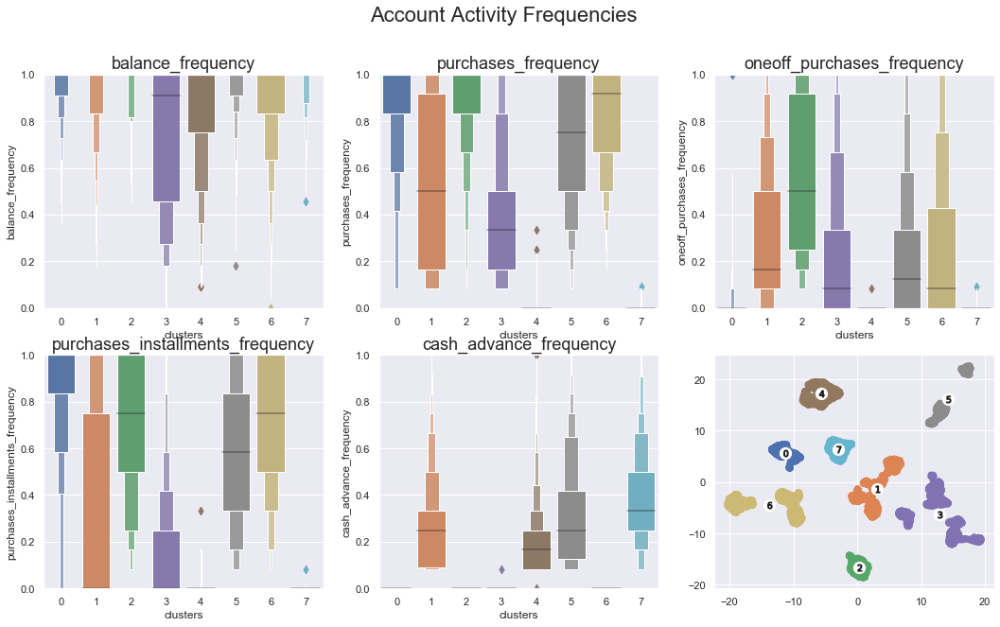

In [0]:
segment_analysis_plots(df, activity, 'clusters', 'Account Activity Frequencies', 
                       clusters=clusters, yax=[1,0])

In [0]:
features_distributions_grid(subsets, activity)

,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
idx,,,,,,,,,
count,575,1520,724,1655,1171,710,1477,804,8636
plot_1: balance_frequency (mean/median),"(0.97, 1.0)","(0.95, 1.0)","(0.98, 1.0)","(0.74, 0.91)","(0.85, 1.0)","(0.97, 1.0)","(0.9, 1.0)","(0.98, 1.0)","(0.9, 1.0)"
plot_2: purchases_frequency (mean/median),"(0.87, 1.0)","(0.53, 0.5)","(0.88, 1.0)","(0.39, 0.33)","(0.0, 0.0)","(0.69, 0.75)","(0.81, 0.92)","(0.0, 0.0)","(0.5, 0.5)"
plot_3: oneoff_purchases_frequency (mean/median),"(0.01, 0.0)","(0.3, 0.17)","(0.54, 0.5)","(0.23, 0.08)","(0.0, 0.0)","(0.23, 0.12)","(0.26, 0.08)","(0.0, 0.0)","(0.21, 0.08)"
plot_4: purchases_installments_frequency (mean/median),"(0.85, 1.0)","(0.33, 0.0)","(0.7, 0.75)","(0.15, 0.0)","(0.0, 0.0)","(0.57, 0.58)","(0.7, 0.75)","(0.0, 0.0)","(0.37, 0.17)"
plot_5: cash_advance_frequency (mean/median),"(0.0, 0.0)","(0.27, 0.25)","(0.0, 0.0)","(0.0, 0.0)","(0.2, 0.17)","(0.32, 0.25)","(0.0, 0.0)","(0.39, 0.33)","(0.14, 0.0)"


In [0]:
clusters_stats_tests(subsets, 'balance_frequency', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,0.974,0.947,0.978,0.739,0.852,0.973,0.896,0.979,0.895
2,median,1.0,1.0,1.0,0.909,1.0,1.0,1.0,1.0,1.0
3,std,0.085,0.135,0.068,0.297,0.238,0.086,0.186,0.066,0.208
4,cluster_0,0.49994,2e-05,0.40636,0.0,0.0,0.30314,0.0,0.39347,0.0
5,cluster_1,2e-05,0.49999,0.0,0.0,0.0,4e-05,0.0,0.0,0.0
6,cluster_2,0.40636,0.0,0.49996,0.0,0.0,0.21755,0.0,0.47428,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49999,0.0,0.00017,0.0,0.0
9,cluster_5,0.30314,4e-05,0.21755,0.0,0.0,0.49996,0.0,0.1962,0.0


In [0]:
clusters_stats_tests(subsets, 'purchases_frequency', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,0.871,0.533,0.881,0.39,0.001,0.688,0.813,0.001,0.496
2,median,1.0,0.5,1.0,0.333,0.0,0.75,0.917,0.0,0.5
3,std,0.238,0.363,0.193,0.289,0.013,0.277,0.216,0.007,0.401
4,cluster_0,0.49996,0.0,0.12109,0.0,0.0,0.0,0.0,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,cluster_2,0.12109,0.0,0.49997,0.0,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49988,0.0,0.0,0.18319,0.0
9,cluster_5,0.0,0.0,0.0,0.0,0.0,0.49997,0.0,0.0,0.0


In [0]:
clusters_stats_tests(subsets, 'oneoff_purchases_frequency', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,0.007,0.298,0.543,0.231,0.0,0.227,0.26,0.001,0.206
2,median,0.0,0.167,0.5,0.083,0.0,0.125,0.083,0.0,0.083
3,std,0.048,0.29,0.331,0.298,0.002,0.272,0.332,0.007,0.3
4,cluster_0,0.49991,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.26424,0.15816,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49976,0.0,0.0,0.01667,0.0
9,cluster_5,0.0,0.0,0.0,0.26424,0.0,0.49997,0.19377,0.0,0.0


In [0]:
clusters_stats_tests(subsets, 'purchases_installments_frequency', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,0.847,0.334,0.702,0.15,0.001,0.567,0.697,0.0,0.369
2,median,1.0,0.0,0.75,0.0,0.0,0.583,0.75,0.0,0.167
3,std,0.258,0.4,0.298,0.239,0.013,0.308,0.276,0.003,0.398
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.0,0.0,4e-05
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,0.08587,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49988,0.0,0.0,0.17236,0.0
9,cluster_5,0.0,0.0,0.0,0.0,0.0,0.49997,0.0,0.0,0.0


In [0]:
# Only clusters 1,4,5 & 7 have cash advance data.
clusters_stats_tests({'cluster_1':c1, 'cluster_4':c4, 'cluster_5':c5, 
                      'cluster_7':c7}, 'cash_advance_frequency', 8)

,idx,cluster_1,cluster_4,cluster_5,cluster_7
0,count,1520,1171,710,804
1,mean,0.271,0.2,0.323,0.387
2,median,0.25,0.167,0.25,0.333
3,std,0.196,0.145,0.231,0.217
4,cluster_1,0.49999,0.0,1e-05,0.0
5,cluster_4,0.0,0.49999,0.0,0.0
6,cluster_5,1e-05,0.0,0.49997,0.0
7,cluster_7,0.0,0.0,0.0,0.49998


The plots demonstrate general activity of customer segments according to the company's description and quantification of frequency.  Based on 'balance_frequency', clusters 0, 2, 5, and 7 are statistically determined as belonging to the same distribution; the most active customer segments.   

#### Purchases & Cash Advances

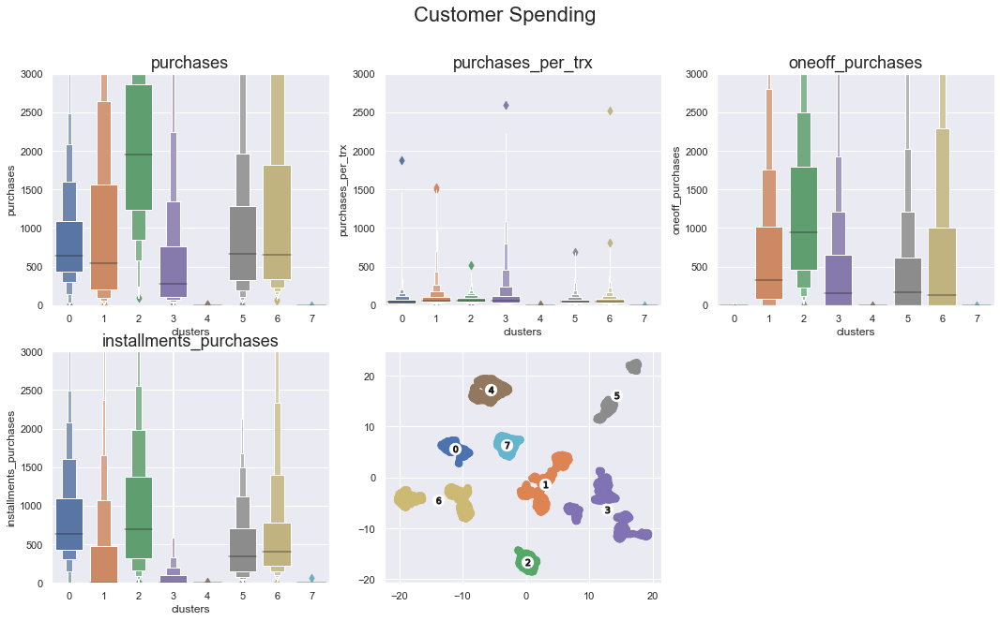

In [0]:
segment_analysis_plots(df, purchasing, 'clusters', 'Customer Spending ', 
                       clusters=clusters, yax=[3000,0])

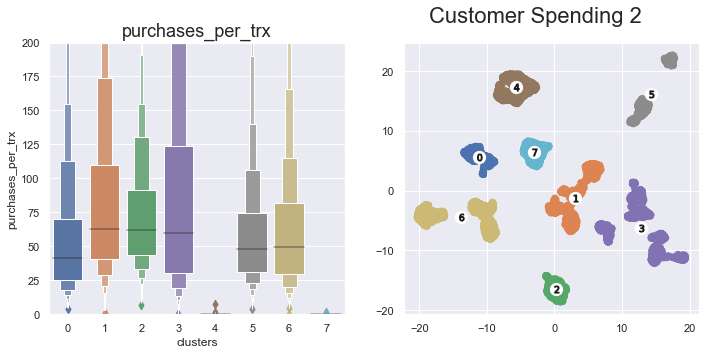

In [0]:
segment_analysis_plots(df, trx, 'clusters', 'Customer Spending 2', 
                       clusters=clusters, yax=[200,0])

At a glance, Cluster 2 is distinguishable as having spent the most through purchases over six months.  With the exception of clusters 4 and 7, Cluster 3 appears to have spent the least.  Other clusters, on average, appear to have spent similar amounts on general purchases.  

While each cluster demonstrates a varied range of amounts spent per transaction, purchases per transaction appear somewhat similar.  Differentiating behaviors may be more easily defined by a deeper dive into data and analyzing spending according to types of purchases and amounts spent. 

In [0]:
purch_data = purchasing + trx + ['cash_advance']

features_distributions_grid(subsets, purch_data)

,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
idx,,,,,,,,,
count,575,1520,724,1655,1171,710,1477,804,8636
plot_1: purchases (mean/median),"(907.75, 638.08)","(1271.05, 549.5)","(2285.65, 1947.94)","(691.41, 282.39)","(0.01, 0.0)","(1099.66, 666.46)","(1910.51, 654.16)","(0.0, 0.0)","(1025.43, 375.4)"
plot_2: purchases_per_trx (mean/median),"(63.65, 41.22)","(105.57, 63.11)","(76.28, 62.38)","(137.43, 60.0)","(0.01, 0.0)","(64.47, 48.23)","(69.22, 49.72)","(0.0, 0.0)","(72.69, 41.63)"
plot_3: oneoff_purchases (mean/median),"(1.76, 0.0)","(851.59, 330.92)","(1313.41, 945.62)","(567.29, 150.05)","(0.0, 0.0)","(554.87, 173.04)","(1113.58, 133.0)","(0.0, 0.0)","(604.9, 45.0)"
plot_4: installments_purchases (mean/median),"(906.13, 638.08)","(419.88, 0.0)","(972.24, 700.52)","(124.61, 0.0)","(0.03, 0.0)","(544.79, 344.16)","(797.66, 401.06)","(0.08, 0.0)","(420.84, 94.78)"
plot_5: purchases_per_trx (mean/median),"(63.65, 41.22)","(105.57, 63.11)","(76.28, 62.38)","(137.43, 60.0)","(0.01, 0.0)","(64.47, 48.23)","(69.22, 49.72)","(0.0, 0.0)","(72.69, 41.63)"
plot_6: cash_advance (mean/median),"(0.0, 0.0)","(1824.29, 1058.49)","(0.0, 0.0)","(0.01, 0.0)","(1118.61, 682.16)","(2567.05, 1523.62)","(0.0, 0.0)","(3333.66, 2676.97)","(994.18, 0.0)"


In [0]:
clusters_stats_tests(subsets, 'purchases', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,907.75,1271.052,2285.649,691.411,0.011,1099.658,1910.511,0.004,1025.434
2,median,638.08,549.5,1947.935,282.39,0.0,666.455,654.16,0.0,375.405
3,std,1203.108,2253.494,1582.64,1256.523,0.25,1609.777,3776.396,0.079,2166.983
4,cluster_0,0.49996,0.01357,0.0,0.0,0.0,0.49816,0.05016,0.0,0.0
5,cluster_1,0.01357,0.49999,0.0,0.0,0.0,0.00771,0.0,0.0,0.0
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.30959
8,cluster_4,0.0,0.0,0.0,0.0,0.49986,0.0,0.0,0.10528,0.0
9,cluster_5,0.49816,0.00771,0.0,0.0,0.0,0.49997,0.00409,0.0,0.0


In [0]:
# Average purchases per month
compare_stats(subsets,'purchases', clusters=8, factor=6)

,idx,cluster0,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,cluster7,all_data
0,count,95.833333,253.333333,120.666667,275.833333,195.166667,118.333333,246.166667,134.000000,1439.333333
1,mean,151.291667,211.841667,380.941667,115.235000,0.001667,183.276667,318.418333,0.000000,170.905000
2,std,200.693333,375.706667,263.955000,209.483333,0.041667,268.485000,629.613333,0.013333,361.185000
3,min,0.831667,1.400000,14.983333,0.001667,0.000000,2.106667,9.945000,0.000000,0.000000
4,25%,71.955000,34.170000,206.490000,18.710000,0.000000,54.738333,55.808333,0.000000,7.228333
5,50%,106.346667,91.583333,324.655000,47.065000,0.000000,111.075000,109.026667,0.000000,62.566667
6,75%,182.433333,260.651667,476.463333,126.105000,0.000000,213.738333,304.026667,0.000000,190.996667
7,max,3750.000000,8173.261667,1979.708333,2990.833333,1.210000,4631.736667,6841.733333,0.333333,8173.261667


In [0]:
clusters_stats_tests(subsets, 'purchases_per_trx', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,63.655,105.57,76.278,137.431,0.008,64.466,69.22,0.004,72.691
2,median,41.223,63.106,62.379,60.0,0.0,48.232,49.72,0.0,41.633
3,std,104.042,152.317,52.025,273.556,0.218,65.619,92.596,0.079,152.998
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.00032,6e-05,0.0,0.00154
5,cluster_1,0.0,0.49999,0.15906,0.01654,0.0,0.0,0.0,0.0,0.0
6,cluster_2,0.0,0.15906,0.49997,0.17569,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.01654,0.17569,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49986,0.0,0.0,0.10515,0.0
9,cluster_5,0.00032,0.0,0.0,0.0,0.0,0.49997,0.35798,0.0,0.0


In [0]:
compare_stats(subsets,'purchases_per_trx', clusters=8, factor=1)

,idx,cluster0,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,cluster7,all_data
0,count,575.00,1520.00,724.00,1655.00,1171.00,710.00,1477.00,804.00,8636.00
1,mean,63.65,105.57,76.28,137.43,0.01,64.47,69.22,0.00,72.69
2,std,104.13,152.37,52.06,273.64,0.22,65.67,92.63,0.08,153.01
3,min,3.66,0.70,6.76,0.00,0.00,3.67,0.00,0.00,0.00
4,25%,25.60,40.54,43.57,30.63,0.00,31.31,29.40,0.00,12.32
5,50%,41.22,63.11,62.38,60.00,0.00,48.23,49.72,0.00,41.63
6,75%,70.15,110.00,91.40,123.91,0.00,74.34,81.75,0.00,78.74
7,max,1875.00,1522.30,522.18,5981.67,7.26,686.78,2523.44,2.00,5981.67


In [0]:
clusters_stats_tests(subsets, 'oneoff_purchases', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,1.761,851.593,1313.413,567.293,0.001,554.871,1113.577,0.004,604.901
2,median,0.0,330.915,945.62,150.05,0.0,173.04,133.0,0.0,44.995
3,std,8.042,1820.597,1253.195,1199.139,0.029,1148.48,2992.996,0.079,1684.21
4,cluster_0,0.49991,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.4812,0.46052,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49976,0.0,0.0,0.01673,0.0
9,cluster_5,0.0,0.0,0.0,0.4812,0.0,0.49997,0.45767,0.0,0.0


In [0]:
# Average one-off purchases per month
compare_stats(subsets,'oneoff_purchases', clusters=8, factor=6)

,idx,cluster0,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,cluster7,all_data
0,count,95.833333,253.333333,120.666667,275.833333,195.166667,118.333333,246.166667,134.000000,1439.333333
1,mean,0.293333,141.931667,218.901667,94.548333,0.000000,92.478333,185.596667,0.000000,100.816667
2,std,1.341667,303.533333,209.010000,199.916667,0.005000,191.548333,499.001667,0.013333,280.718333
3,min,0.000000,0.000000,1.666667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
4,25%,0.000000,13.718333,75.911667,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000
5,50%,0.000000,55.151667,157.603333,25.008333,0.000000,28.840000,22.166667,0.000000,7.500000
6,75%,0.000000,168.863333,299.513333,108.333333,0.000000,102.585000,167.696667,0.000000,99.850000
7,max,8.333333,6793.541667,1439.455000,2990.833333,0.166667,2434.331667,6770.676667,0.333333,6793.541667


In [0]:
clusters_stats_tests(subsets, 'purchases_installments_frequency', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,0.847,0.334,0.702,0.15,0.001,0.567,0.697,0.0,0.369
2,median,1.0,0.0,0.75,0.0,0.0,0.583,0.75,0.0,0.167
3,std,0.258,0.4,0.298,0.239,0.013,0.308,0.276,0.003,0.398
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.0,0.0,4e-05
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,0.08587,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49988,0.0,0.0,0.17236,0.0
9,cluster_5,0.0,0.0,0.0,0.0,0.0,0.49997,0.0,0.0,0.0


In [0]:
# Average installments purchases per month
compare_stats(subsets,'installments_purchases', clusters=8, factor=6)

,idx,cluster0,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,cluster7,all_data
0,count,95.833333,253.333333,120.666667,275.833333,195.166667,118.333333,246.166667,134.000000,1439.333333
1,mean,151.021667,69.980000,162.040000,20.768333,0.005000,90.798333,132.943333,0.013333,70.140000
2,std,200.901667,153.051667,150.736667,88.068333,0.105000,123.593333,222.720000,0.393333,152.875000
3,min,0.000000,0.000000,1.666667,0.000000,0.000000,2.106667,1.278333,0.000000,0.000000
4,25%,71.955000,0.000000,53.436667,0.000000,0.000000,25.000000,37.896667,0.000000,0.000000
5,50%,106.346667,0.000000,116.751667,0.000000,0.000000,57.358333,66.843333,0.000000,15.796667
6,75%,182.433333,79.653333,229.458333,16.666667,0.000000,118.100000,131.106667,0.000000,80.691667
7,max,3750.000000,2447.683333,987.776667,2062.500000,3.333333,2197.405000,2582.865000,11.158333,3750.000000


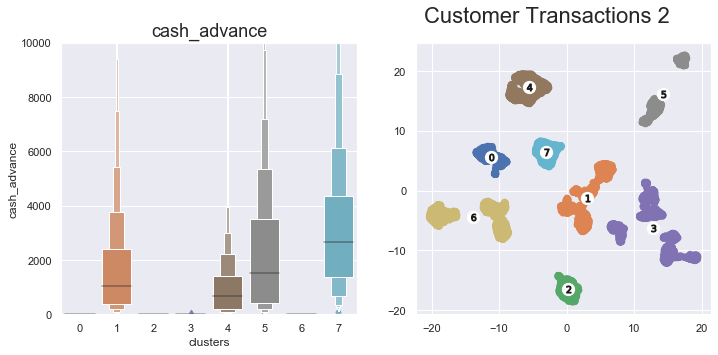

In [0]:
segment_analysis_plots(df, ['cash_advance'], 'clusters', 
                       'Customer Transactions 2', clusters=clusters, yax=[10000,0])

In [0]:
clusters_stats_tests({'cluster_1':c1, 'cluster_4':c4, 'cluster_5':c5, 
                      'cluster_7':c7}, 'cash_advance', 4)

,idx,cluster_1,cluster_4,cluster_5,cluster_7
0,count,1520,1171,710,804
1,mean,1824.293,1118.612,2567.046,3333.655
2,median,1058.494,682.156,1523.624,2676.97
3,std,2320.608,1799.268,3513.793,2847.254
4,cluster_1,0.49999,0.0,0.0,0.0
5,cluster_4,0.0,0.49999,0.0,0.0
6,cluster_5,0.0,0.0,0.49997,0.0
7,cluster_7,0.0,0.0,0.0,0.49998


In [0]:
# Average cash advance per month
compare_stats(subsets,'cash_advance', clusters=8, factor=6)

,idx,cluster0,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,cluster7,all_data
0,count,95.833333,253.333333,120.666667,275.833333,195.166667,118.333333,246.166667,134.000000,1439.333333
1,mean,0.000000,304.048333,0.000000,0.001667,186.435000,427.841667,0.000000,555.610000,165.696667
2,std,0.000000,386.895000,0.000000,0.075000,300.006667,586.045000,0.000000,474.838333,353.576667
3,min,0.000000,2.370000,0.000000,0.000000,0.000000,3.103333,0.000000,15.785000,0.000000
4,25%,0.000000,64.930000,0.000000,0.000000,32.830000,72.280000,0.000000,231.625000,0.000000
5,50%,0.000000,176.415000,0.000000,0.000000,113.693333,253.936667,0.000000,446.161667,0.000000
6,75%,0.000000,402.320000,0.000000,0.000000,234.803333,586.036667,0.000000,727.548333,188.731667
7,max,0.000000,4880.351667,0.000000,3.046667,4365.675000,7856.201667,0.000000,3657.308333,7856.201667


#### Transactions

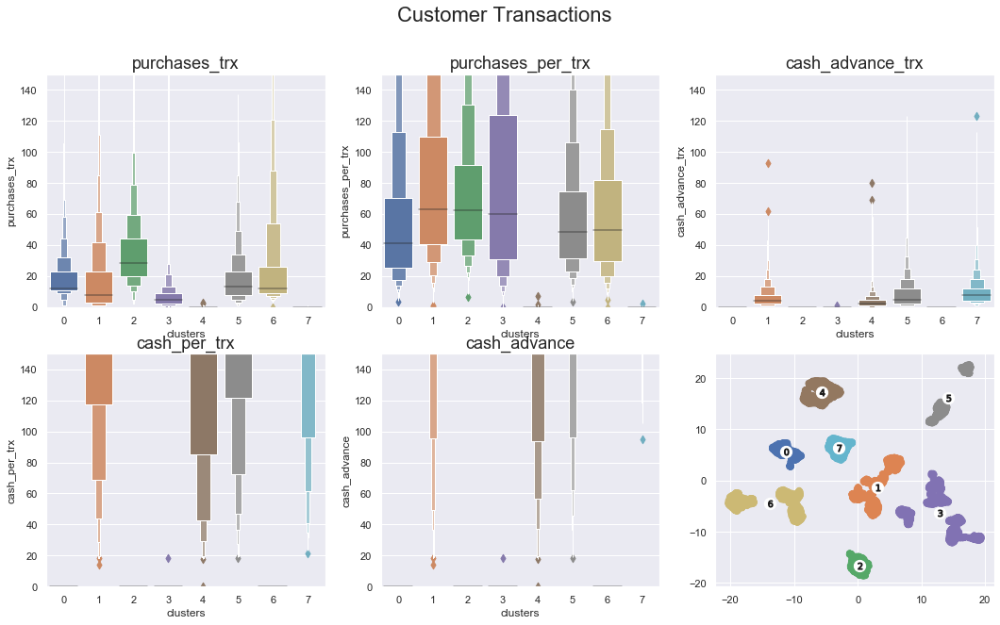

In [0]:
segment_analysis_plots(df, transactions + ['cash_advance'], 'clusters', 
                       'Customer Transactions', clusters=clusters, yax=[150,0])

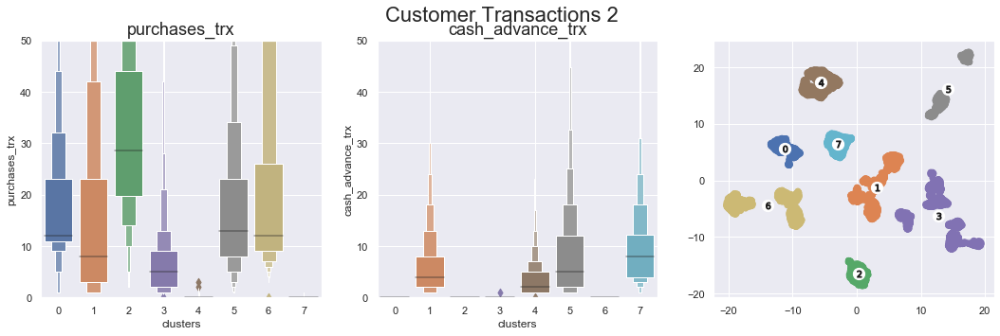

In [0]:
segment_analysis_plots(df, ['purchases_trx', 'cash_advance_trx'], 'clusters', 
                       'Customer Transactions 2', clusters=clusters, yax=[50,0])

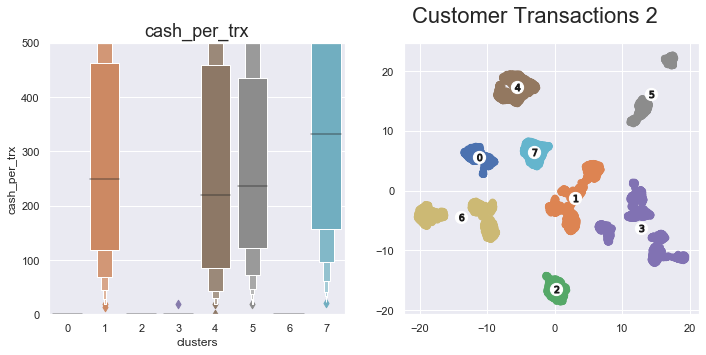

In [0]:
segment_analysis_plots(df, ['cash_per_trx'], 'clusters', 
                       'Customer Transactions 2', clusters=clusters, yax=[500,0])

The similarity of account holders with cash transactions is interesting.  In all cases, the number of transactions seems to be low while the average amounts seem more than purchases.  In two of the four segments (Cluster 4 & Cluster 7), cash transactions are the only usage of the account.  Visually, the clusters appear distinctly spaced from each other.  Further exploration is required to determine distinguishing characteristics.

In [0]:
clusters_stats_tests(subsets, 'purchases_trx', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,18.784,18.413,35.227,7.573,0.008,18.731,26.871,0.006,15.033
2,median,12.0,8.0,28.5,5.0,0.0,13.0,12.0,0.0,7.0
3,std,16.976,28.589,25.565,12.169,0.12,18.537,37.068,0.079,25.179
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.00367,0.23254,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.0,0.0,0.0
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.4999,0.0,0.0,0.37533,0.0
9,cluster_5,0.00367,0.0,0.0,0.0,0.0,0.49997,0.00022,0.0,0.0


In [0]:
# Average purchases trx per month
compare_stats(subsets,'purchases_trx', clusters=8, factor=6)

,idx,cluster0,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,cluster7,all_data
0,count,95.833333,253.333333,120.666667,275.833333,195.166667,118.333333,246.166667,134.000000,1439.333333
1,mean,3.130000,3.068333,5.871667,1.261667,0.001667,3.121667,4.478333,0.001667,2.505000
2,std,2.831667,4.766667,4.263333,2.028333,0.020000,3.091667,6.180000,0.013333,4.196667
3,min,0.166667,0.166667,0.333333,0.000000,0.000000,0.166667,0.000000,0.000000,0.000000
4,25%,1.833333,0.500000,3.291667,0.333333,0.000000,1.333333,1.500000,0.000000,0.166667
5,50%,2.000000,1.333333,4.750000,0.833333,0.000000,2.166667,2.000000,0.000000,1.166667
6,75%,3.833333,3.833333,7.333333,1.500000,0.000000,3.833333,4.333333,0.000000,3.000000
7,max,33.166667,57.833333,38.666667,36.166667,0.500000,30.333333,59.666667,0.166667,59.666667


In [0]:
clusters_stats_tests(subsets, 'purchases_per_trx', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,63.655,105.57,76.278,137.431,0.008,64.466,69.22,0.004,72.691
2,median,41.223,63.106,62.379,60.0,0.0,48.232,49.72,0.0,41.633
3,std,104.042,152.317,52.025,273.556,0.218,65.619,92.596,0.079,152.998
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.00032,6e-05,0.0,0.00154
5,cluster_1,0.0,0.49999,0.15906,0.01654,0.0,0.0,0.0,0.0,0.0
6,cluster_2,0.0,0.15906,0.49997,0.17569,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.01654,0.17569,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49986,0.0,0.0,0.10515,0.0
9,cluster_5,0.00032,0.0,0.0,0.0,0.0,0.49997,0.35798,0.0,0.0


In [0]:
clusters_stats_tests({'cluster_1':c1, 'cluster_4':c4, 'cluster_5':c5, 
                      'cluster_7':c7}, 'cash_advance_trx', 4)

,idx,cluster_1,cluster_4,cluster_5,cluster_7
0,count,1520,1171,710,804
1,mean,6.309,3.856,8.98,10.122
2,median,4.0,2.0,5.0,8.0
3,std,7.298,5.221,11.626,10.041
4,cluster_1,0.49999,0.0,0.0,0.0
5,cluster_4,0.0,0.49999,0.0,0.0
6,cluster_5,0.0,0.0,0.49997,0.0
7,cluster_7,0.0,0.0,0.0,0.49998


In [0]:
# Average cash advance transactions per month
compare_stats(subsets,'cash_advance_trx', clusters=8, factor=6)

,idx,cluster0,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,cluster7,all_data
0,count,95.833333,253.333333,120.666667,275.833333,195.166667,118.333333,246.166667,134.000000,1439.333333
1,mean,0.000000,1.051667,0.000000,0.000000,0.643333,1.496667,0.000000,1.686667,0.551667
2,std,0.000000,1.216667,0.000000,0.003333,0.870000,1.938333,0.000000,1.675000,1.151667
3,min,0.000000,0.166667,0.000000,0.000000,0.000000,0.166667,0.000000,0.166667,0.000000
4,25%,0.000000,0.333333,0.000000,0.000000,0.166667,0.333333,0.000000,0.666667,0.000000
5,50%,0.000000,0.666667,0.000000,0.000000,0.333333,0.833333,0.000000,1.333333,0.000000
6,75%,0.000000,1.333333,0.000000,0.000000,0.833333,2.000000,0.000000,2.041667,0.666667
7,max,0.000000,15.500000,0.000000,0.166667,13.333333,20.500000,0.000000,20.500000,20.500000


In [0]:
clusters_stats_tests({'cluster_1':c1, 'cluster_4':c4, 'cluster_5':c5, 
                      'cluster_7':c7}, 'cash_per_trx', 4)

,idx,cluster_1,cluster_4,cluster_5,cluster_7
0,count,1520,1171,710,804
1,mean,390.699,412.267,380.19,555.124
2,median,248.861,218.819,236.806,331.027
3,std,559.998,661.462,702.096,911.025
4,cluster_1,0.49999,0.00298,0.34319,0.0
5,cluster_4,0.00298,0.49999,0.02486,0.0
6,cluster_5,0.34319,0.02486,0.49997,0.0
7,cluster_7,0.0,0.0,0.0,0.49998


#### Account Management

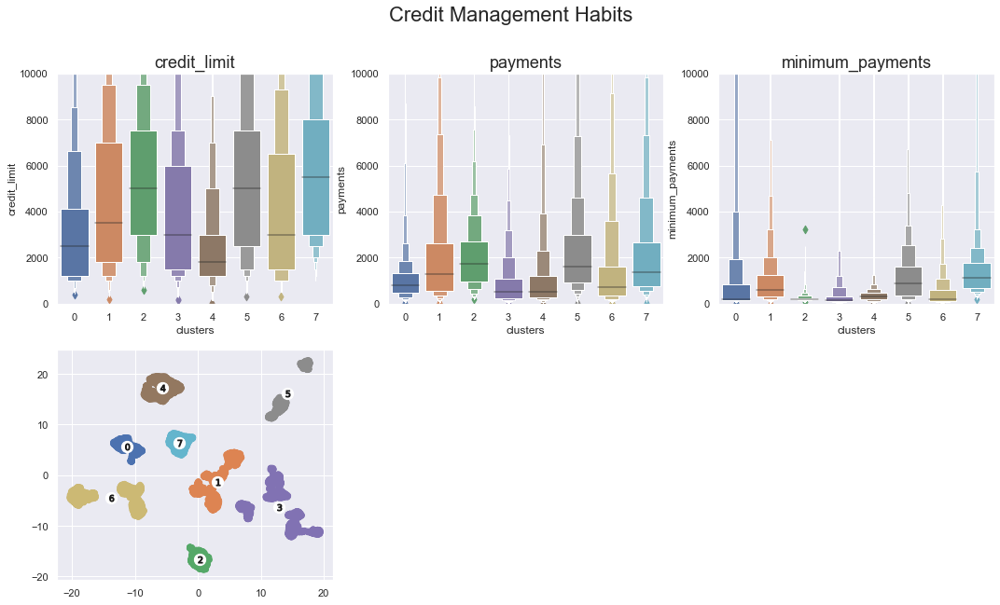

In [0]:
segment_analysis_plots(df, payments, 'clusters', 'Credit Management Habits', 
                       clusters=clusters, yax=[10000,0])

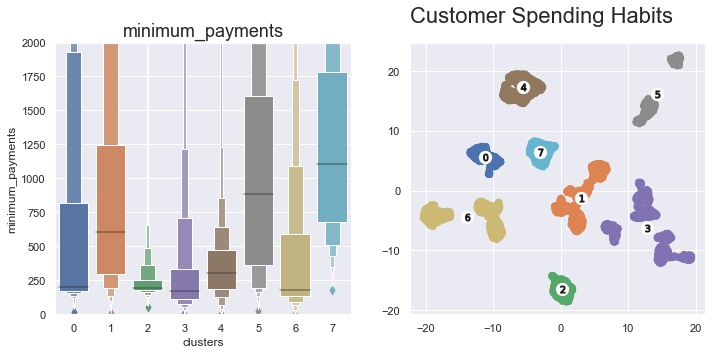

In [0]:
segment_analysis_plots(df, payments2, 'clusters', 'Customer Spending Habits', 
                       clusters=clusters, yax=[2000,0])

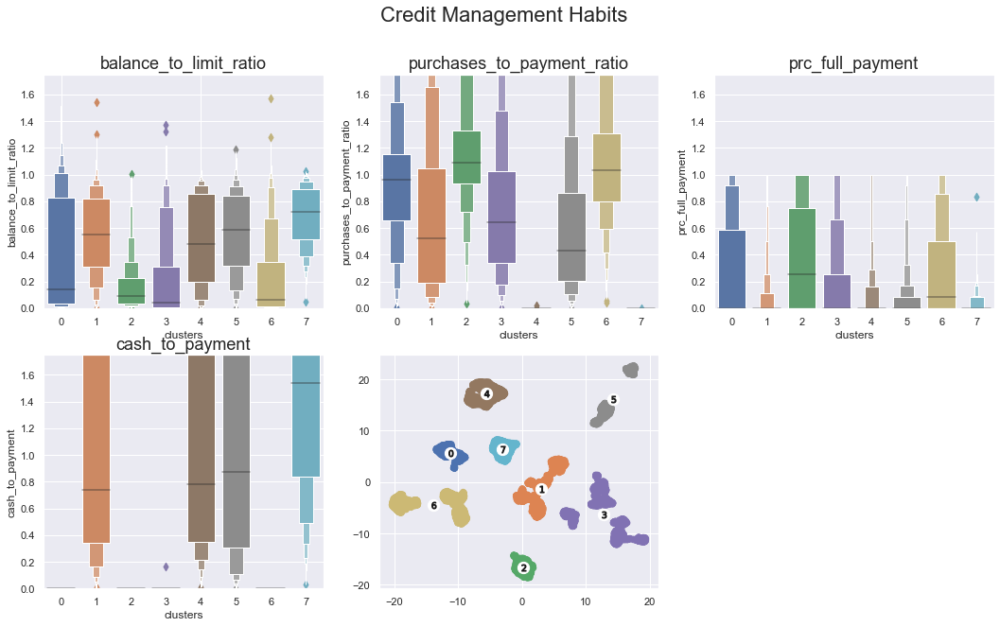

In [0]:
segment_analysis_plots(df, ratios, 'clusters', 'Credit Management Habits', 
                       clusters=clusters, yax=[1.75,0])

In [0]:
acct_mng = payments + payments2 + ratios

features_distributions_grid(subsets, acct_mng)

,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
idx,,,,,,,,,
count,575,1520,724,1655,1171,710,1477,804,8636
plot_1: credit_limit (mean/median),"(3392.43, 2500.0)","(4879.92, 3500.0)","(5677.74, 5000.0)","(4014.33, 3000.0)","(2675.42, 1800.0)","(5640.23, 5000.0)","(4679.61, 3000.0)","(6070.9, 5500.0)","(4522.09, 3000.0)"
plot_2: payments (mean/median),"(1134.85, 791.09)","(2348.8, 1287.94)","(2124.89, 1749.05)","(1025.57, 510.92)","(1306.83, 536.03)","(2669.82, 1618.53)","(1796.92, 711.61)","(2328.84, 1351.81)","(1784.48, 896.68)"
plot_3: minimum_payments (mean/median),"(1437.79, 197.92)","(1139.58, 607.63)","(252.98, 195.31)","(519.25, 170.97)","(476.57, 301.63)","(1368.59, 884.02)","(612.75, 175.29)","(1776.04, 1105.43)","(864.3, 312.45)"
plot_4: minimum_payments (mean/median),"(1437.79, 197.92)","(1139.58, 607.63)","(252.98, 195.31)","(519.25, 170.97)","(476.57, 301.63)","(1368.59, 884.02)","(612.75, 175.29)","(1776.04, 1105.43)","(864.3, 312.45)"
plot_5: balance_to_limit_ratio (mean/median),"(0.38, 0.14)","(0.55, 0.55)","(0.17, 0.09)","(0.22, 0.04)","(0.52, 0.48)","(0.56, 0.59)","(0.23, 0.06)","(0.69, 0.72)","(0.4, 0.32)"
plot_6: purchases_to_payment_ratio (mean/median),"(1.09, 0.96)","(0.89, 0.52)","(1.35, 1.09)","(1.01, 0.64)","(0.0, 0.0)","(0.75, 0.43)","(1.4, 1.03)","(0.0, 0.0)","(0.84, 0.57)"
plot_7: prc_full_payment (mean/median),"(0.28, 0.0)","(0.06, 0.0)","(0.37, 0.25)","(0.19, 0.0)","(0.07, 0.0)","(0.07, 0.0)","(0.27, 0.08)","(0.02, 0.0)","(0.16, 0.0)"
plot_8: cash_to_payment (mean/median),"(0.0, 0.0)","(1.66, 0.74)","(0.0, 0.0)","(0.0, 0.0)","(8.74, 0.78)","(1.53, 0.87)","(0.0, 0.0)","(2.5, 1.54)","(1.84, 0.0)"


In [0]:
clusters_stats_tests(subsets, 'payments', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,1134.852,2348.798,2124.893,1025.573,1306.827,2669.821,1796.916,2328.835,1784.478
2,median,791.092,1287.944,1749.046,510.918,536.03,1618.531,711.607,1351.814,896.676
3,std,1296.91,3517.762,1683.098,2023.393,2667.463,3604.925,3461.737,2826.784,2909.642
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.0,0.13484,0.0,0.00039
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.0,0.0,0.00081,0.0
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.4557,0.0,0.00073,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.00581,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.00581,0.49999,0.0,0.0,0.0,0.0
9,cluster_5,0.0,0.0,0.4557,0.0,0.0,0.49997,0.0,0.00172,0.0


In [0]:
# Average minimum payments per month
compare_stats(subsets,'minimum_payments', clusters=8, factor=6)

,idx,cluster0,cluster1,cluster2,cluster3,cluster4,cluster5,cluster6,cluster7,all_data
0,count,95.833333,253.333333,120.666667,275.833333,195.166667,118.333333,246.166667,134.000000,1439.333333
1,mean,239.631667,189.930000,42.163333,86.541667,79.428333,228.098333,102.125000,296.006667,144.050000
2,std,769.578333,298.366667,33.218333,402.548333,242.283333,365.808333,269.056667,593.955000,395.428333
3,min,2.913333,0.533333,8.938333,0.003333,0.020000,4.566667,0.043333,29.660000,0.003333
4,25%,28.443333,50.023333,29.348333,18.350000,31.513333,59.905000,22.021667,113.641667,28.193333
5,50%,32.986667,101.271667,32.551667,28.495000,50.271667,147.336667,29.215000,184.238333,52.075000
6,75%,137.041667,207.360000,42.108333,55.768333,78.758333,268.016667,98.565000,297.101667,137.583333
7,max,9395.006667,3176.755000,539.900000,12734.368333,7188.788333,5311.893333,4836.633333,10171.936667,12734.368333


In [0]:
clusters_stats_tests(subsets, 'purchases_to_payment_ratio', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,1.088,0.888,1.351,1.011,0.0,0.754,1.398,0.0,0.837
2,median,0.96,0.52,1.093,0.641,0.0,0.429,1.035,0.0,0.572
3,std,1.086,1.422,1.11,2.144,0.0,1.559,3.04,0.0,1.856
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.0,0.00547,0.0,0.0,0.0
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,3e-05,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0
8,cluster_4,0.0,0.0,0.0,0.0,0.49986,0.0,0.0,0.10521,0.0
9,cluster_5,0.0,0.00547,0.0,0.0,0.0,0.49997,0.0,0.0,0.44032


In [0]:
clusters_stats_tests(subsets, 'prc_full_payment', 8)

,idx,cluster_0,cluster_1,cluster_2,cluster_3,cluster_4,cluster_5,cluster_6,cluster_7,all_data
0,count,575,1520,724,1655,1171,710,1477,804,8636
1,mean,0.282,0.058,0.369,0.188,0.065,0.069,0.275,0.018,0.159
2,median,0.0,0.0,0.25,0.0,0.0,0.0,0.083,0.0,0.0
3,std,0.375,0.158,0.388,0.322,0.173,0.18,0.358,0.057,0.296
4,cluster_0,0.49996,0.0,0.0,0.0,0.0,0.0,0.28112,0.0,0.0
5,cluster_1,0.0,0.49999,0.0,0.0,0.18807,0.1507,0.0,0.0,0.0
6,cluster_2,0.0,0.0,0.49997,0.0,0.0,0.0,0.0,0.0,0.0
7,cluster_3,0.0,0.0,0.0,0.49999,0.0,0.0,0.0,0.0,0.0043
8,cluster_4,0.0,0.18807,0.0,0.0,0.49998,0.40259,0.0,0.0,0.0
9,cluster_5,0.0,0.1507,0.0,0.0,0.40259,0.49997,0.0,0.0,0.0


In [0]:
clusters_stats_tests({'cluster_1':c1, 'cluster_4':c4, 'cluster_5':c5, 
                      'cluster_7':c7}, 'cash_to_payment', 4)

,idx,cluster_1,cluster_4,cluster_5,cluster_7
0,count,1520,1171,710,804
1,mean,1.66,8.738,1.535,2.499
2,median,0.736,0.784,0.873,1.54
3,std,3.018,212.692,2.371,3.115
4,cluster_1,0.49999,0.01518,0.15648,0.0
5,cluster_4,0.01518,0.49999,0.19734,0.0
6,cluster_5,0.15648,0.19734,0.49997,0.0
7,cluster_7,0.0,0.0,0.0,0.49998


## Conclusion

Using UMAP for dimensionality reduction allows for a better visual division of customer segments.  There is a noticeable separation in clusters 1, 3, 5, and 6 that could be either an indication of sub-segments or a "ripping" of clusters that is associated with UMAP.

### Customer 0 

* Credit limit between 400-7500
* Not a lot of credit "purchasing"; spends more on installments
* Spending tends to be higher than payments
* Overall low credit usage

### Customer 1 

* Credit limit between 150-3000
* Doesn't purchase with card; opts for cash advance
* Cash advances don't exceed payments made, but are close
* Carries balance of about 60% of the limit

### Customer 2 

* Credit limit between 300-7000
* Lower amounts of spending, mostly purchases
* Spending tends to be much lower than payments made
* High credit usage (approaching maxed out)|

### Customer 3

* Credit limit between 150-4200
* Low spending, mostly installments
* Spending tends to be around 75% of payment amounts made
* Very low credit usage (approaching regular zero balance)

### Customer 4 

* Credit limit between 200-7500
* Regular card use for both purchases and installments
* Spending tends to be around 25% lower than payments made
* Credit usage:  Maintains balance around 50% of limit

### Customer 5 

* Credit limit between 150-6000
* Regularly uses card for one-off low spending, not many installments
* Spending tends to be close to payment amound
* Very low credit usage (approaching regular zero balance)

### Customer 6 

* Credit limit between 50-8625
* Card primarily used for cash advance, little to no spending
* Cash advances generally exceed payments made
* High credit usage; around 75% of limit

### Customer 7

* Credit limit between 50-6500
* Higher spending in both one-off and installments; more one-off
* Spending tends to be nearly equal to payments
* Very low credit usage (approaching regular zero balance)